# Implementing K Means clustering for the antobody mean escape over time.

This line gets rid of some warnings about the packages when you run the code:

In [1]:
import warnings
warnings.filterwarnings('ignore')

Download necessary package versions

In [2]:
#!conda install -y numpy=1.24

In [3]:
#!pip install umap-learn

Import Python packages

In [4]:
import os
import glob
from collections import defaultdict
import pandas as pd

#Packages for plotting
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import matplotlib.colors as colors

#Packages for K Means Clustering: 
from sklearn.cluster import KMeans
from scipy.spatial.distance import cdist
import numpy as np

#Packages for umap
import umap

Read in data that predicts how much each virus has escaped each antibody

In [5]:


#f = '/fh/fast/matsen_e/shared/dmsa-pred/ncov-dmsa/results/cao_predictions_231103/imprinted_2022_abs/all_predictions.csv'
f = '/fh/fast/matsen_e/shared/dmsa-pred/ncov-dmsa/results/cao_predictions/imprinted_2022_abs/escaped-clinically-approved-abs/all_predictions.csv'
escape_df = pd.read_csv(f)

escape_df.rename(columns={'group':'ab_group'}, inplace=True)
escape_df['escape_score'].clip(upper=1.0, inplace=True)
escape_df.head()

,strain,all_aa_substitutions,measured_aa_substitutions,unmeasured_aa_substitutions,disallowed_aa_substitutions,n_disallowed_aa_substitutions,escape_score,antibody,ab_group,date,Nextstrain_clade,time
0,Wuhan-Hu-1/2019,NaN,NaN,NaN,NaN,0,0.0,BD55-6049,E3,2019-12-26,19A,0.008219
1,Wuhan-Hu-1/2019,NaN,NaN,NaN,NaN,0,0.0,BD56-965,B,2019-12-26,19A,0.008219
2,Wuhan-Hu-1/2019,NaN,NaN,NaN,NaN,0,0.0,XGv-318,F1,2019-12-26,19A,0.008219
3,Wuhan-Hu-1/2019,NaN,NaN,NaN,NaN,0,0.0,BD55-5687,E3,2019-12-26,19A,0.008219
4,Wuhan-Hu-1/2019,NaN,NaN,NaN,NaN,0,0.0,XGv-214,E2.1,2019-12-26,19A,0.008219


Next, for each antibody group, we'll plot escape over time. To do this, we'll need to implement our sliding-window approach from before. First, we will define where our windows are.

In [6]:
# Define parameters for windows
start_time = 0
end_time = 3.5
window_width = 0.2
window_step_size = 0.1

# To start, we set the left side of our window at a value
# of zero
left_side_of_window = 0

# We're going to define all windows one at a time
# based on the step size and width
list_of_left_sides_of_windows = []
while left_side_of_window <= end_time:
    
    # Append the window value to the list
    list_of_left_sides_of_windows.append(left_side_of_window)
    #print(left_side_of_window, left_side_of_window+window_width)

    # Slide the window to the right by one step
    left_side_of_window = left_side_of_window + window_step_size
escape_df.head()

,strain,all_aa_substitutions,measured_aa_substitutions,unmeasured_aa_substitutions,disallowed_aa_substitutions,n_disallowed_aa_substitutions,escape_score,antibody,ab_group,date,Nextstrain_clade,time
0,Wuhan-Hu-1/2019,NaN,NaN,NaN,NaN,0,0.0,BD55-6049,E3,2019-12-26,19A,0.008219
1,Wuhan-Hu-1/2019,NaN,NaN,NaN,NaN,0,0.0,BD56-965,B,2019-12-26,19A,0.008219
2,Wuhan-Hu-1/2019,NaN,NaN,NaN,NaN,0,0.0,XGv-318,F1,2019-12-26,19A,0.008219
3,Wuhan-Hu-1/2019,NaN,NaN,NaN,NaN,0,0.0,BD55-5687,E3,2019-12-26,19A,0.008219
4,Wuhan-Hu-1/2019,NaN,NaN,NaN,NaN,0,0.0,XGv-214,E2.1,2019-12-26,19A,0.008219


Next, for each window, we will record data in that window.

In [7]:
# Make a dictionary for keeping track of averages in each window
window_data = defaultdict(list)

ab_groups = sorted(escape_df['ab_group'].unique())

# Iterate over each window and record data
dfs = []
for left_side_of_window in list_of_left_sides_of_windows:

    # Get the right side of the window
    right_side_of_window = left_side_of_window + window_width
   
    # Record data for specific antibody group
    for ab_group in ab_groups:
       
        # Get data for all rows in a given time window
        data = escape_df[
            (escape_df['time'].between(left_side_of_window, right_side_of_window)) &
            (escape_df['ab_group'] == ab_group)
        ].copy()

        # Compute the mean escape across all viruses for a given antibody
        data = data.groupby('antibody').mean(numeric_only=True)
        data['time'] = left_side_of_window
        data['ab_group'] = ab_group
        dfs.append(data)
           
ab_window_data = pd.concat(dfs)
ab_window_data.rename(columns={'escape_score' : 'mean_escape'}, inplace=True)
ab_window_data.reset_index(inplace=True)
print(ab_window_data.info())
ab_window_data.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 97230 entries, 0 to 97229
Data columns (total 5 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   antibody                       97230 non-null  object 
 1   n_disallowed_aa_substitutions  97230 non-null  float64
 2   mean_escape                    97230 non-null  float64
 3   time                           97230 non-null  float64
 4   ab_group                       97230 non-null  object 
dtypes: float64(3), object(2)
memory usage: 3.7+ MB
None


,antibody,n_disallowed_aa_substitutions,mean_escape,time,ab_group
0,B38,0.337963,0.0,0.0,A
1,BD-218,0.337963,0.0,0.0,A
2,BD-236,0.337963,0.0,0.0,A
3,BD-369,0.337963,0.0,0.0,A
4,BD-395,0.337963,0.0,0.0,A


Now, let's plot ALL of the data together and see our mean antibody escape over time for all ~3000 antibodies

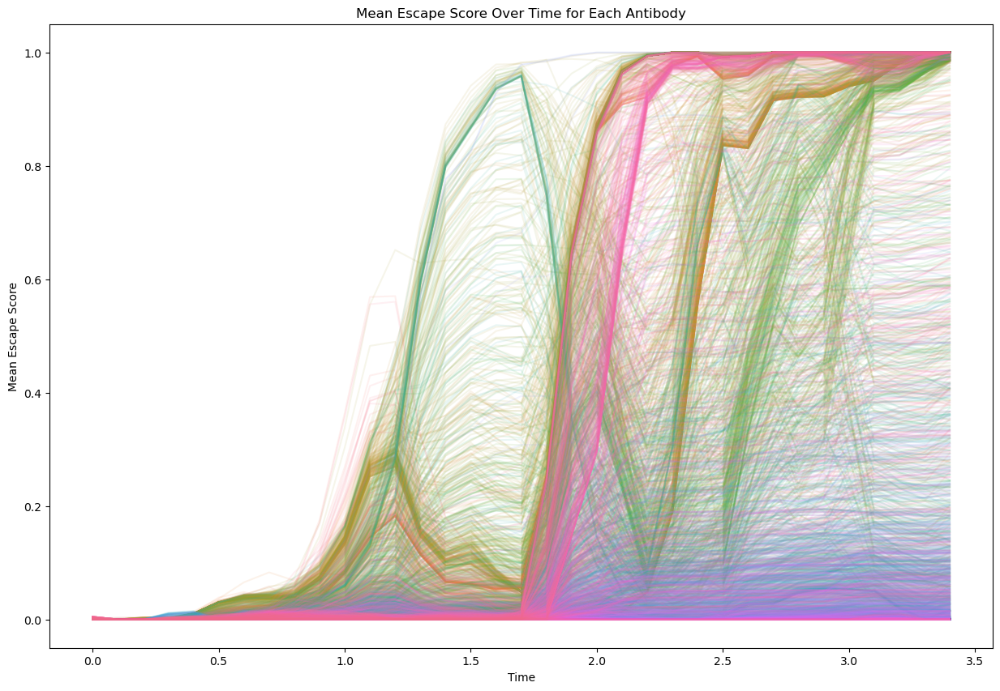

In [8]:
plt.figure(figsize=(15, 10))
sns.lineplot(data=ab_window_data, x='time', y='mean_escape', hue='antibody', legend=False, alpha=.1)

plt.title('Mean Escape Score Over Time for Each Antibody')
plt.xlabel('Time')
plt.ylabel('Mean Escape Score')
plt.show()

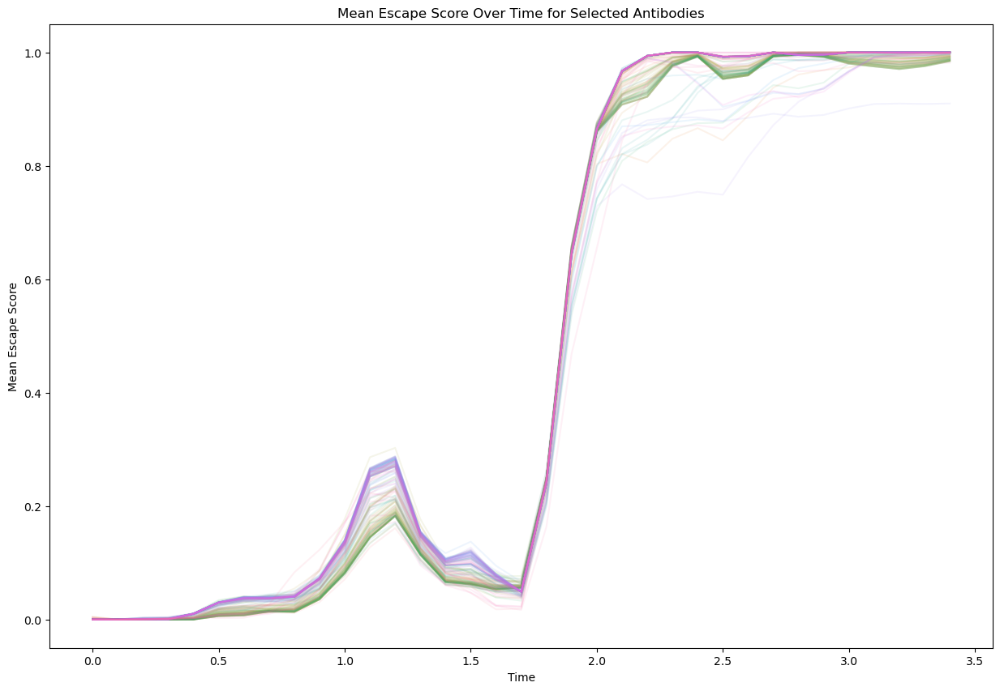

In [10]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load the filtered DataFrame from the CSV file
filtered_df = pd.read_csv('Results/filtered_df.csv')

# Ensure that the 'antibody' column is in a format that can be used for filtering (e.g., string if they are names)
filtered_df['antibody'] = filtered_df['antibody'].astype(str)

# Filter 'ab_window_data' to only include rows where the 'antibody' is in 'filtered_df'
filtered_ab_window_data = ab_window_data[ab_window_data['antibody'].isin(filtered_df['antibody'])]


# Create the line plot with the filtered data
plt.figure(figsize=(15, 10))
sns.lineplot(data=filtered_ab_window_data, x='time', y='mean_escape', hue='antibody', legend=False, alpha=.1)

plt.title('Mean Escape Score Over Time for Selected Antibodies')
plt.xlabel('Time')
plt.ylabel('Mean Escape Score')
plt.show()


# Creating a distance matrix 
* This code will calculate the euclidian distance between each antibody
* That data will be stored in a matrix that is 2778 antibodies tall and 2778 antibodies wide, since this is a euclidian distance matrix


In [11]:
# # This function calculates the Euclidean distance between two vectors (vec1 and vec2).
# # The distance is calculated as the square root of the sum of squared differences between corresponding elements of the vectors.
# def euclidean_distance(vec1, vec2):
#     return np.sqrt(np.sum((vec1 - vec2) ** 2))

# # Identify all unique antibodies in our dataset.
# antibodies = ab_window_data['antibody'].unique()

# # Create an empty dictionary called 'antibody_dict'.
# # This dictionary will store the trajectory of mean_escape values for each antibody.
# antibody_dict = {}
# # Loop through each unique antibody to populate the dictionary.
# for ab in antibodies:
#     # Filter the rows in ab_window_data where the antibody is the one we're looking at ('ab').
#     # Sort these rows based on the 'time' column.
#     # Extract the 'mean_escape' values into a NumPy array.
#     # Store this array in the 'antibody_dict' dictionary under the key named after the antibody.
#     traj = ab_window_data[ab_window_data['antibody'] == ab].sort_values(by='time')['mean_escape'].values
#     antibody_dict[ab] = traj

# # Create an empty DataFrame called 'distance_matrix'.
# # The row and column names are the unique antibodies.
# # This DataFrame will be used to store the Euclidean distances between each pair of antibodies.
# distance_matrix = pd.DataFrame(index=antibodies, columns=antibodies)

# # Start a nested loop to go through each pair of antibodies.
# # For each pair (ab1, ab2), we will calculate the Euclidean distance between their trajectories.
# for ab1 in antibodies:
#     for ab2 in antibodies:
#         # If the antibodies are the same, the distance is zero.
#         if ab1 == ab2:
#             distance_matrix.loc[ab1, ab2] = 0.0
#         else:
#             # If the antibodies are different, we fetch their trajectories from 'antibody_dict'.
#             traj1 = antibody_dict[ab1]
#             traj2 = antibody_dict[ab2]
            
#             # Assert to check the trajectories are the same length 
#             assert len(traj1) == len(traj2)
            
            
            
#             # Calculate the Euclidean distance between the two trajectories using our function from before.
#             # Store this distance value in the corresponding cell of the 'distance_matrix' DataFrame.
#             distance = euclidean_distance(traj1, traj2)
#             distance_matrix.loc[ab1, ab2] = distance

# #Now display the matrix         
# print(distance_matrix)

## Turn the Dataframe in to a CSV file for future use

In [12]:
##Here too is new uncomment 
# distance_matrix.to_csv('Results/distance_matrix.csv')

# Now, lets display the UMAP analysis
* Note, this is not the final alaysis, we will do further analysis by coloring each dot
* This will be done at the end of the Python Notebook so we can have all of the data we need to do so

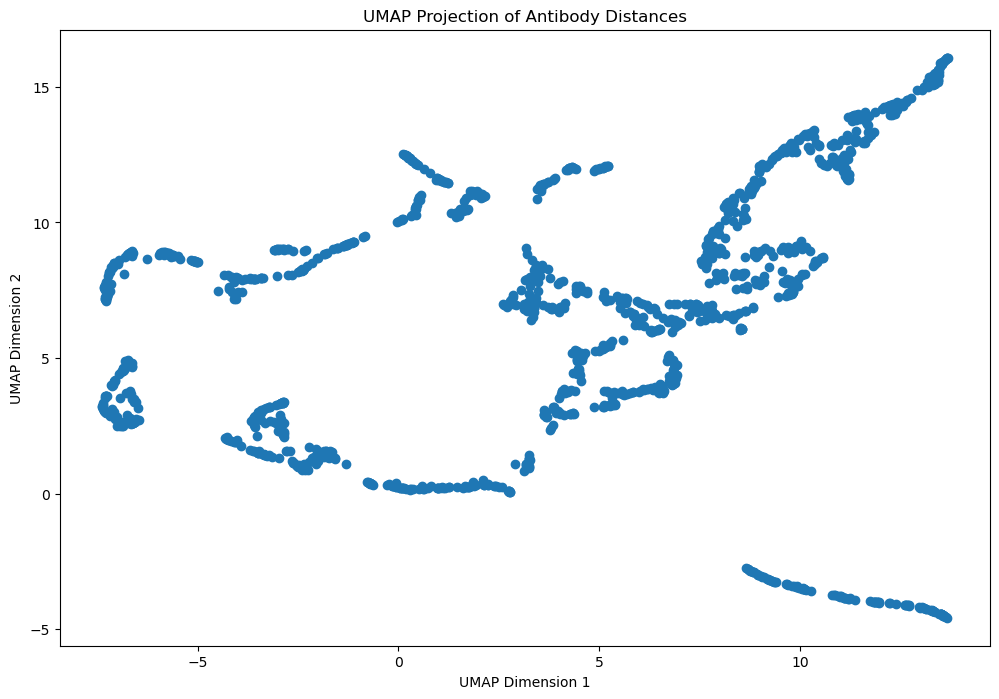

In [13]:
# Read the saved distance_matrix from the CSV file
distance_matrix = pd.read_csv('Results/distance_matrix.csv', index_col=0)

# make sure the dataframe is of type float
distance_matrix = distance_matrix.astype(float)

# Create a UMAP model
umap_model = umap.UMAP(random_state=42)  # Using seed to get same results every time

# Fit the model to data 
embedding = umap_model.fit_transform(distance_matrix)

# Extract the 2D coordinates
x_coords = embedding[:, 0]
y_coords = embedding[:, 1]

# Create a scatter plot
plt.figure(figsize=(12, 8))
plt.scatter(x_coords, y_coords)


plt.xlabel('UMAP Dimension 1')
plt.ylabel('UMAP Dimension 2')
plt.title('UMAP Projection of Antibody Distances')

plt.show()

## K-Means Clustering on Antibody Escape Data Over Time

Now, we'll walk through the following steps:

1. **Data Pivoting**: Reshaping the dataset to set each antibody as a row and time points as columns.
2. **Optimal Cluster Determination**: Using the Elbow method to deduce the best cluster count for K-Means.
3. **K-Means Clustering**: Applying K-Means based on the optimal or pre-defined cluster count.
4. **Visualization**: Plotting the resulting clusters to observe antibody behavior over time.


# To start, pivot the dataframe to have one row per antibody and one column per time point

In [14]:
pivot_df = ab_window_data.pivot(index=['antibody', 'ab_group'], columns= 'time', values='mean_escape').fillna(0)
#this is for ones with y that exceeds 0.2
#pivot_df = pivot_df.loc[(pivot_df.drop('antibody', axis=1) > 0.2).any(axis=1)]
pivot_df = pivot_df.loc[(pivot_df > 0.2).any(axis=1)]



# This function will be applied to each cell in the DataFrame
def truncate_values(value):
    if value > 0.7:
        return 0.7
    else:
        return value

# Apply function to every cell in the DataFrame
pivot_df = pivot_df.applymap(truncate_values)
pivot_df


,time,0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,...,2.5,2.6,2.7,2.8,2.9,3.0,3.1,3.2,3.3,3.4
antibody,ab_group,,,,,,,,,,,,,,,,,,,,,
1-57,D1,0.000000,0.000048,0.000044,0.000000,0.000065,0.000153,0.000549,0.007980,0.006030,0.003625,...,0.168439,0.408546,0.394802,0.26041,0.36138,0.659968,0.7,0.7,0.7,0.7
2-15,C,0.000000,0.000000,0.000526,0.000620,0.010204,0.030480,0.042006,0.040987,0.039823,0.073481,...,0.700000,0.700000,0.700000,0.70000,0.70000,0.700000,0.7,0.7,0.7,0.7
7D6,C,0.000000,0.000000,0.000187,0.000221,0.010204,0.030120,0.039527,0.038966,0.039823,0.072562,...,0.700000,0.700000,0.700000,0.70000,0.70000,0.700000,0.7,0.7,0.7,0.7
ADG-2,F3,0.003703,0.000000,0.000000,0.000000,0.001356,0.005312,0.006344,0.009141,0.012349,0.016737,...,0.700000,0.700000,0.700000,0.70000,0.70000,0.700000,0.7,0.7,0.7,0.7
B38,A,0.000000,0.000000,0.000733,0.002324,0.005279,0.030257,0.036134,0.022555,0.036077,0.085145,...,0.700000,0.700000,0.700000,0.70000,0.70000,0.700000,0.7,0.7,0.7,0.7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
XGv-409,B,0.000000,0.000286,0.000595,0.000392,0.000847,0.002563,0.005260,0.013019,0.008983,0.006001,...,0.700000,0.700000,0.700000,0.70000,0.70000,0.700000,0.7,0.7,0.7,0.7
XGv-412,E1,0.000000,0.000000,0.000000,0.000000,0.000000,0.002073,0.002476,0.000170,0.016819,0.021528,...,0.436296,0.606672,0.700000,0.70000,0.70000,0.700000,0.7,0.7,0.7,0.7
XGv-416,F2,0.002545,0.000000,0.000000,0.000000,0.000438,0.001294,0.001546,0.001524,0.001711,0.003049,...,0.700000,0.700000,0.700000,0.70000,0.70000,0.700000,0.7,0.7,0.7,0.7


In [15]:
##########################new under 2 distance matrix

In [16]:
# # This function calculates the Euclidean distance between two vectors (vec1 and vec2).
# # The distance is calculated as the square root of the sum of squared differences between corresponding elements of the vectors.
# def euclidean_distance(vec1, vec2):
#     return np.sqrt(np.sum((vec1 - vec2) ** 2))
# ##**********************************************************
# ## TRUNCATING VALUES
# # This function will be applied to each cell in the 'mean_escape' column
# def truncate_values(value):
#     if value > 0.7:
#         return 0.7
#     else:
#         return value

# # Apply function to the 'mean_escape' column
# ab_window_data['mean_escape'] = ab_window_data['mean_escape'].apply(truncate_values)


# ##******************************************************
# # Identify all unique antibodies in our dataset.
# antibodies = pivot_df.index.get_level_values('antibody').unique()


# # Create an empty dictionary called 'antibody_dict'.
# # This dictionary will store the trajectory of mean_escape values for each antibody.
# antibody_dict = {}
# # Loop through each unique antibody to populate the dictionary.
# for ab in antibodies:
#     # Filter the rows in ab_window_data where the antibody is the one we're looking at ('ab').
#     # Sort these rows based on the 'time' column.
#     # Extract the 'mean_escape' values into a NumPy array.
#     # Store this array in the 'antibody_dict' dictionary under the key named after the antibody.
#     traj = ab_window_data[ab_window_data['antibody'] == ab].sort_values(by='time')['mean_escape'].values
#     antibody_dict[ab] = traj

# # Create an empty DataFrame called 'distance_matrix'.
# # The row and column names are the unique antibodies.
# # This DataFrame will be used to store the Euclidean distances between each pair of antibodies.
# distance_matrix = pd.DataFrame(index=antibodies, columns=antibodies)

# # Start a nested loop to go through each pair of antibodies.
# # For each pair (ab1, ab2), we will calculate the Euclidean distance between their trajectories.
# for ab1 in antibodies:
#     for ab2 in antibodies:
#         # If the antibodies are the same, the distance is zero.
#         if ab1 == ab2:
#             distance_matrix.loc[ab1, ab2] = 0.0
#         else:
#             # If the antibodies are different, we fetch their trajectories from 'antibody_dict'.
#             traj1 = antibody_dict[ab1]
#             traj2 = antibody_dict[ab2]
            
#             # Assert to check the trajectories are the same length 
#             assert len(traj1) == len(traj2)
            
            
            
#             # Calculate the Euclidean distance between the two trajectories using our function from before.
#             # Store this distance value in the corresponding cell of the 'distance_matrix' DataFrame.
#             distance = euclidean_distance(traj1, traj2)
#             distance_matrix.loc[ab1, ab2] = distance

# #Now display the matrix         
# print(distance_matrix)

In [17]:
distance_matrix.head()

,1-57,2-15,7D6,ADG-2,B38,BD-196,BD-218,BD-236,BD-254,BD-255,...,XGv-347,XGv-360,XGv-387,XGv-404,XGv-405,XGv-409,XGv-412,XGv-416,XGv-420,XGv-421
antibody,,,,,,,,,,,,,,,,,,,,,
1-57,0.000000,1.535768,1.529297,1.458298,1.545400,1.592882,0.853925,1.534635,1.523134,0.962441,...,1.329160,1.458909,1.485464,1.085815,1.526871,1.249051,0.941052,1.450168,0.639812,1.456363
2-15,1.535768,0.000000,0.023235,0.542950,0.071858,0.312292,1.977508,0.083843,0.044854,1.633737,...,1.549567,0.436686,0.206930,0.650465,2.397039,1.244941,0.825623,0.536076,1.379430,0.467722
7D6,1.529297,0.023235,0.000000,0.526001,0.074670,0.326895,1.971997,0.076998,0.022451,1.626829,...,1.542210,0.419736,0.186678,0.641205,2.392718,1.237097,0.814431,0.516372,1.372264,0.446937
ADG-2,1.458298,0.542950,0.526001,0.000000,0.571099,0.693609,1.812975,0.542844,0.509628,1.392672,...,1.277007,0.111766,0.415725,0.462316,2.254439,0.971540,0.629410,0.161542,1.265235,0.336097
B38,1.545400,0.071858,0.074670,0.571099,0.000000,0.333482,1.988461,0.049415,0.084838,1.647730,...,1.564865,0.464798,0.229335,0.669278,2.405988,1.262337,0.845902,0.564911,1.391482,0.493533


In [18]:
#distance_matrix.to_csv('Results/distance_matrix.csv')

In [19]:
##########################endf of new under 2 

In [20]:
###HERE I MAKE TAKE OUT CLUSTER 0 ANTIBODIES FROM PIVOT. COMMENT THIS OUT IF YOU WANT NORMAL
# pivot_df = pivot_df[~pivot_df.index.get_level_values('antibody').isin(antibodies_in_cluster_0['Antibody'])]
# pivot_df


### Determining the Optimal Number of Clusters
Here, we're employing the Elbow method. This visual technique helps find the number of clusters where the rate of reduction in distortion slows down, suggesting an optimal cluster count.


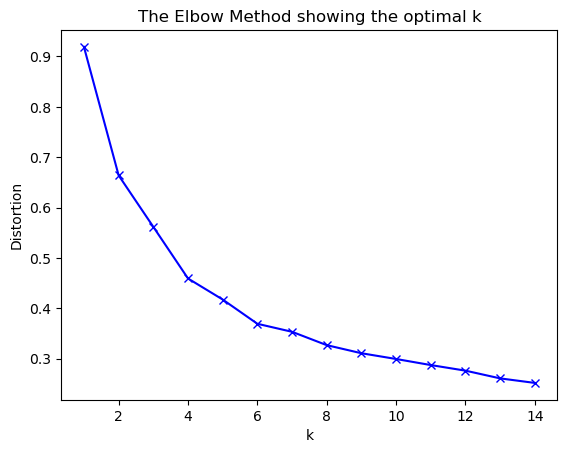

In [21]:
# Compute optimal number of clusters using Elbow method
distortions = []
K = range(1,15) # This range can be adjusted depending on use case
for k in K:
    kmeanModel = KMeans(n_clusters=k, random_state=0)
    kmeanModel.fit(pivot_df)
    distortions.append(sum(np.min(cdist(pivot_df, kmeanModel.cluster_centers_, 'euclidean'), axis=1)) / pivot_df.shape[0])

# Plot the elbow
plt.plot(K, distortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortion')
plt.title('The Elbow Method showing the optimal k')
plt.show()


## Interpretation of the Plot

* The "elbow" is observed to occur within the 2-4k range, suggesting that 2-4 is the optimal number of clusters.
* For this analysis, we've chosen 12 clusters. The rationale behind this choice will be shown in the upcoming cells.


### K-Means Clustering Application
After deducing or choosing the number of clusters, we proceed to segment the data using K-Means.


In [22]:
# Pick the optimal number of clusters by examining the elbow plot
n_clusters = 9 # change this based on your elbow plot result

#NOTE: we chose a large K value due to the large dataset we used

# Perform k-means clustering
kmeans = KMeans(n_clusters=n_clusters, random_state=0, max_iter = 8000).fit(pivot_df)

# Add the cluster labels back into the pivot dataframe
pivot_df['cluster'] = kmeans.labels_

### Visualizing Clustering Results
For each identified cluster, we visualize antibodies over time. This allows us to observe patterns and compare the behavior of different antibodies and antibody groups.


First we will make a dataframe that will be able to hold the average trajecotries that will be portrayed in each cluster:

In [23]:
mean_trajectory_df = pd.DataFrame(columns=['cluster', 'time', 'mean_value'])

Now lets plot the clusters and record the mean trajecotory data in our new data frame

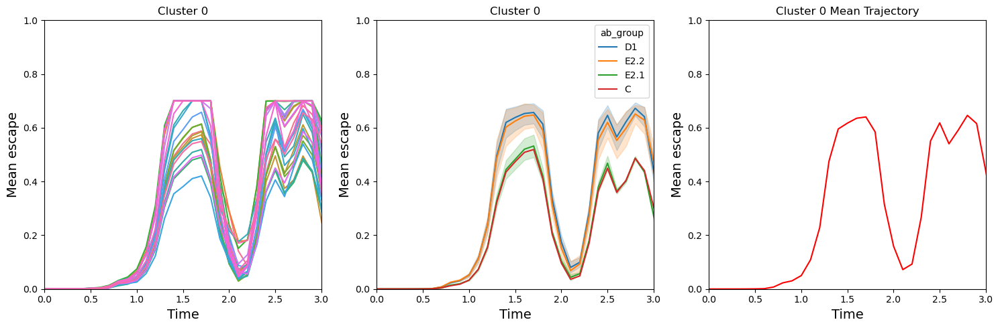

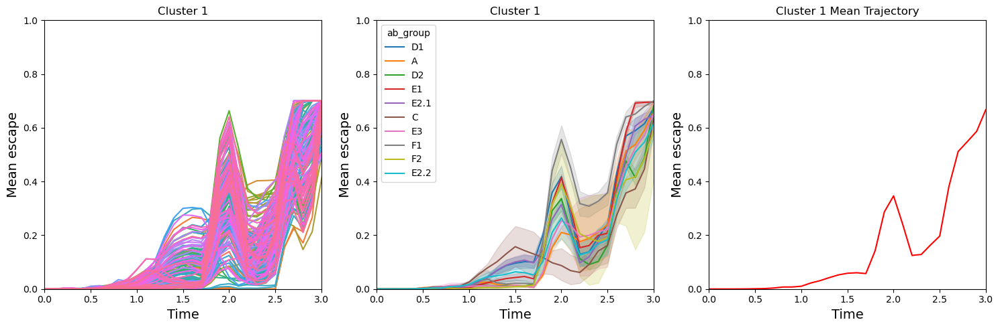

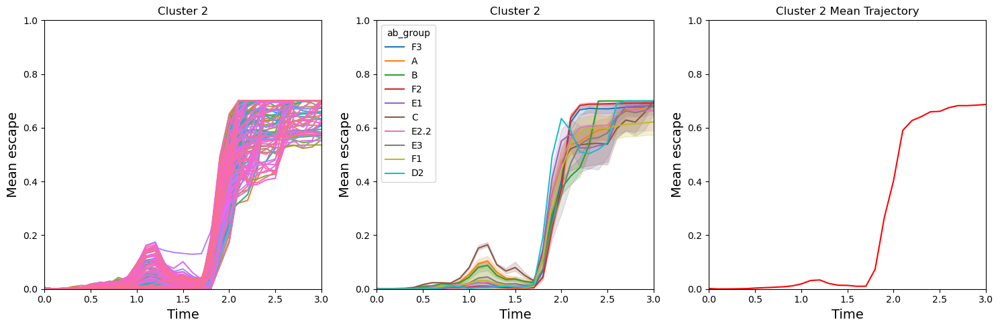

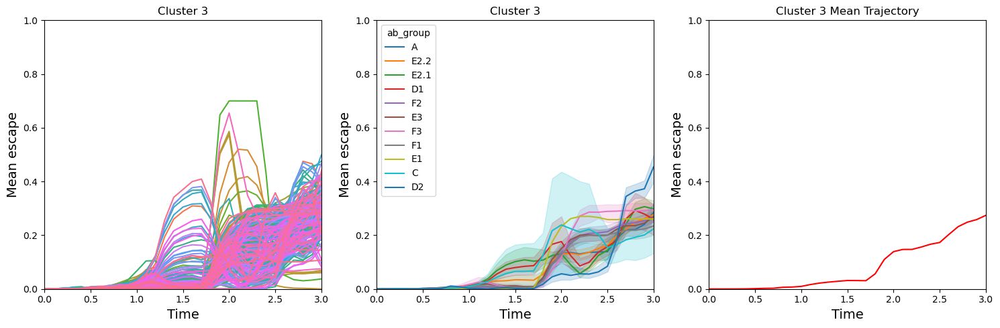

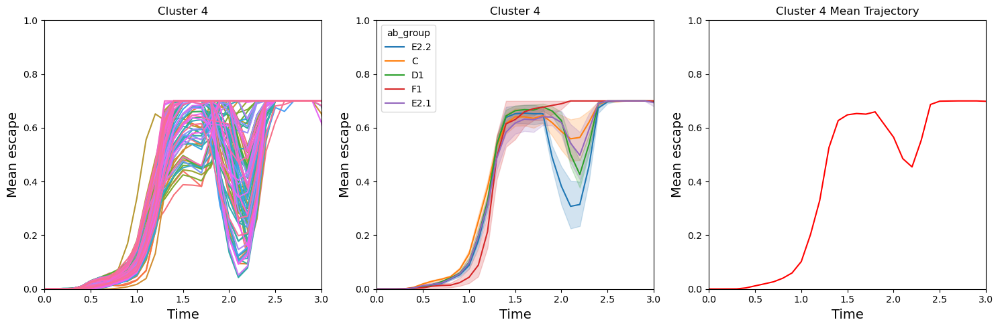

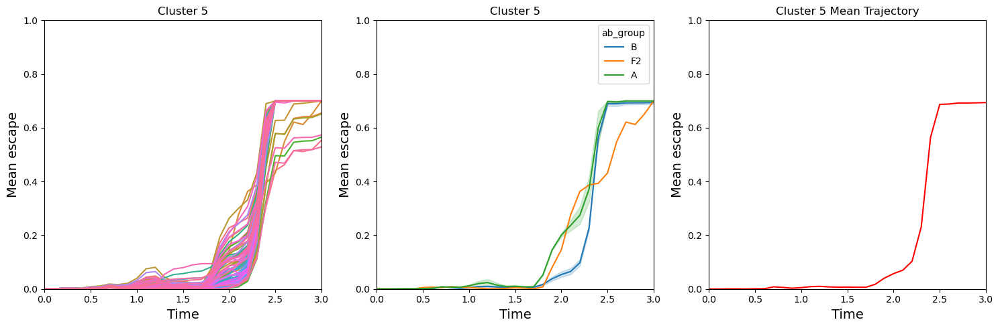

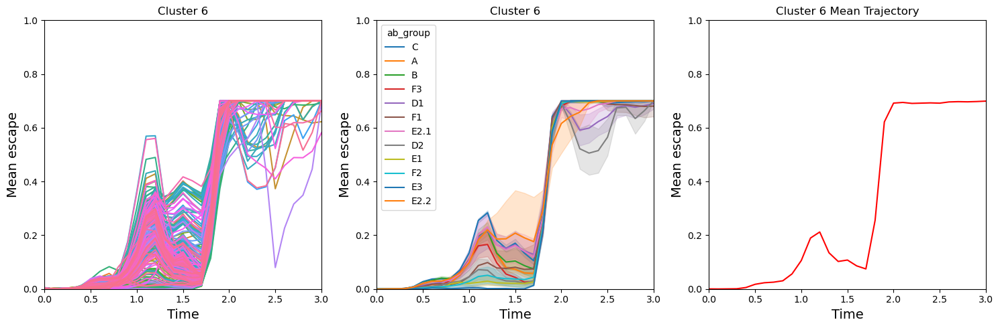

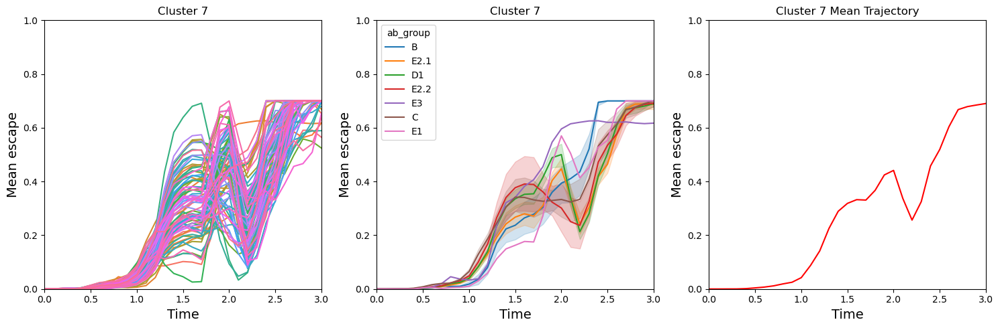

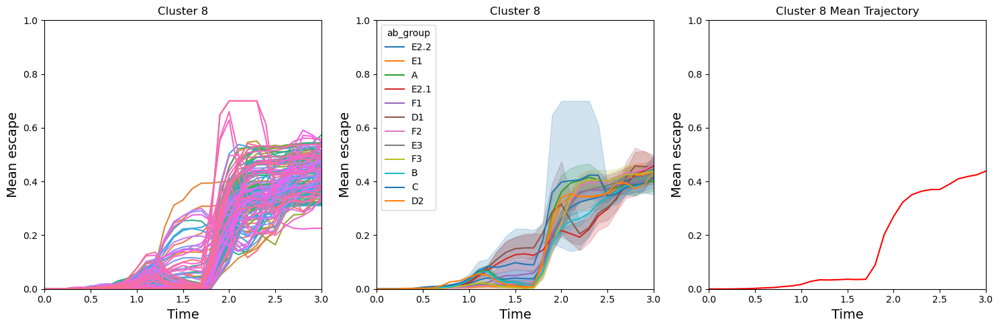

In [24]:
# Initialize an empty DataFrame for storing mean trajectory data
mean_trajectory_df = pd.DataFrame()

# Initialize a dictionary to hold the count of antibodies in each cluster
antibody_count_per_cluster = {}

# DataFrame to store the antibody-cluster mapping
antibody_cluster_df = pd.DataFrame(columns=['Cluster', 'Antibody'])  # New Line

# Assuming 'n_clusters' and 'pivot_df' are already defined
for cluster in range(n_clusters):
    cluster_df = pivot_df[pivot_df['cluster'] == cluster].drop(columns='cluster').reset_index()
    cluster_df = cluster_df.melt(id_vars=['ab_group', 'antibody'])
    cluster_df.time = cluster_df.time.astype(float)
    
    # Count the number of unique antibodies in this cluster and update the dictionary
    num_antibodies = cluster_df['antibody'].nunique()
    antibody_count_per_cluster[cluster] = num_antibodies
    
    # Get the unique antibodies in this cluster
    unique_antibodies = cluster_df['antibody'].unique()  
    
    # Create a DataFrame mapping each unique antibody to this cluster
    temp_df = pd.DataFrame({'Cluster': [cluster]*len(unique_antibodies), 'Antibody': unique_antibodies})  # New Line
    
    # Append this mapping to antibody_cluster_df
    antibody_cluster_df = pd.concat([antibody_cluster_df, temp_df], ignore_index=True)  # New Line
    
    # Calculate mean trajectory for this cluster
    mean_trajectory = cluster_df.groupby('time')['value'].mean().reset_index()
    mean_trajectory['cluster'] = cluster
    
    # Append the mean trajectory to the DataFrame
    mean_trajectory_df = pd.concat([mean_trajectory_df, mean_trajectory.rename(columns={'value': 'mean_value'})])
    
    # Start subplots
    fig, axs = plt.subplots(1, 3, figsize=(15, 5))
    
    # Normal plot with all antibodies in the cluster
    sns.lineplot(data=cluster_df, x='time', y='value', hue='antibody', ax=axs[0], legend=False)
    axs[0].set_title(f'Cluster {cluster}')
    axs[0].set_xlabel('Time', fontsize=14)
    axs[0].set_ylabel('Mean escape', fontsize=14)
    
    # Plot classified by antibody group
    sns.lineplot(data=cluster_df, x='time', y='value', hue='ab_group', palette='tab10', ax=axs[1])
    axs[1].set_title(f'Cluster {cluster}')
    axs[1].set_xlabel('Time', fontsize=14)
    axs[1].set_ylabel('Mean escape', fontsize=14)
    
    # Plot displaying mean trajectory
    sns.lineplot(data=cluster_df, x='time', y='value', ci=None, estimator=np.mean, color='r', ax=axs[2])
    axs[2].set_title(f'Cluster {cluster} Mean Trajectory')
    axs[2].set_xlabel('Time', fontsize=14)
    axs[2].set_ylabel('Mean escape', fontsize=14)
    
    # set x and y axis limits
    axs[0].set_xlim([0, 3])
    axs[0].set_ylim([0, 1])
    axs[1].set_xlim([0, 3])
    axs[1].set_ylim([0, 1])
    axs[2].set_xlim([0, 3])
    axs[2].set_ylim([0, 1])
    
    # Show the plot
    plt.tight_layout()
    plt.show()



In [25]:
antibody_cluster_df.head()

,Cluster,Antibody
0,0,BD55-5946
1,0,BD55-616
2,0,BD55-977
3,0,BD56-032
4,0,BD56-068


In [26]:
###For CLuster 0 ## comment out once done making the file.
# antibodies_in_cluster_0 = antibody_cluster_df[antibody_cluster_df['Cluster'] == 0]['Antibody']
# antibodies_in_cluster_0.to_csv('Results/antibodies_in_cluster_0.csv')
# antibodies_in_cluster_0.head()

### Now, we turn the antibody_cluster_df dataframe which contains each antibody in a column, and each corresponding cluster for that antibody in another column, into a csv file for use in the umap analysis

In [27]:
antibody_cluster_df.to_csv('Results/antibody_cluster_df.csv')

Bar chart representing the number of antibodies in each cluster

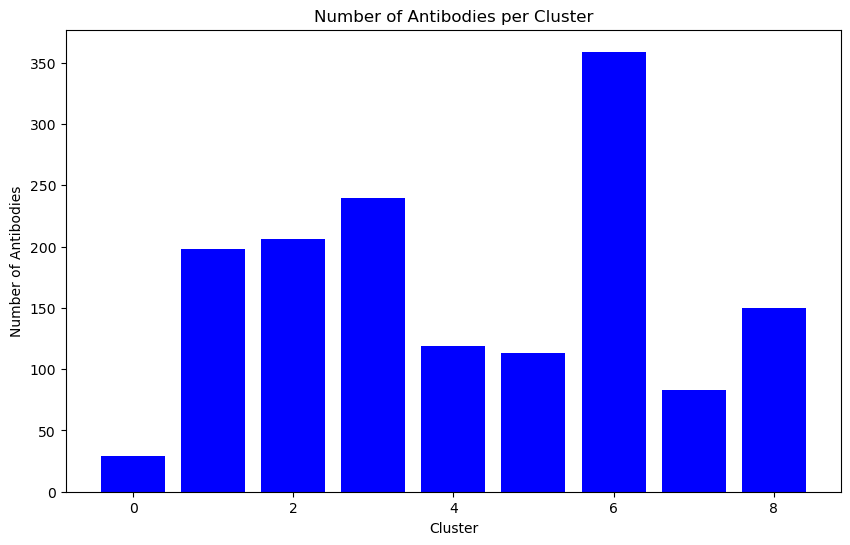

In [28]:
# Plotting the bar chart showing the number of antibodies in each cluster
plt.figure(figsize=(10,6))
plt.bar(antibody_count_per_cluster.keys(), antibody_count_per_cluster.values(), color='b')
plt.xlabel('Cluster')
plt.ylabel('Number of Antibodies')
plt.title('Number of Antibodies per Cluster')
plt.show()

Now, using the mean trajctory Data Frame we created above and the data we filled it with from each cluster iteration, lets plot all the trajectories and see how they compare using a seaborne function called relplot:

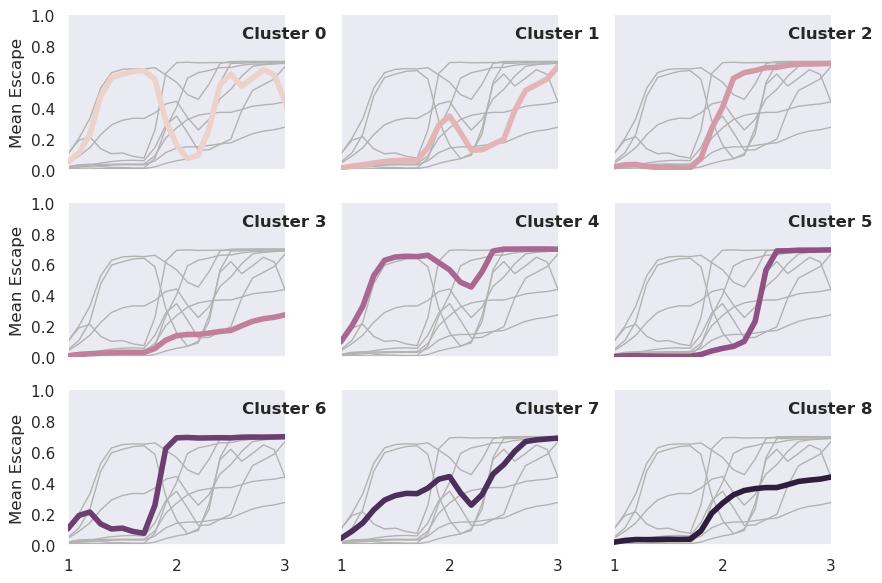

In [29]:
#Inspiration for this code came from https://seaborn.pydata.org/examples/timeseries_facets.html

# Set theme
sns.set_theme(style="dark")

# Create the relplot
g = sns.relplot(
    data=mean_trajectory_df,
    x="time", y="mean_value", col="cluster", hue="cluster",
    kind="line", linewidth=4, zorder=5,
    col_wrap=3, height=2, aspect=1.5, legend=False,
)

# Iterate over each subplot to customize further
for cluster, ax in g.axes_dict.items():

    # Add the title as an annotation within the plot
    ax.text(.8, .85, f"Cluster {cluster}", transform=ax.transAxes, fontweight="bold")

    # Plot all clusters' time series in the background (this is optional)
    sns.lineplot(
        data=mean_trajectory_df, x="time", y="mean_value", units="cluster",
        estimator=None, color=".7", linewidth=1, ax=ax,
    )
    
    # Set x and y axis limits for each subplot
    ax.set_xlim([1, 3])
    ax.set_ylim([0, 1])
    
# make the ticks less
ax.set_xticks(ax.get_xticks()[::2])

# Tweak the supporting aspects of the plot
g.set_titles("")
g.set_axis_labels("", "Mean Escape")
g.tight_layout()

plt.show()


## Analysis of the Results 

* The data exhibits multiple variations of patterns spanning the last ~3000 antibodies graphed.
* Clusters do not align perfectly with antibody groups. This means that an antibody's group classification doesn't necessarily dictate its pattern.
* There's a noticeable dip in some graphs around the 2-year mark. This coincides with the emergence of the Omicron variant.
    * Prior to Omicron, a succession of variants of concern emerged. Each new variant repplaced its predecessor.
    * Omicron's eventual dominance suggests its initial lack of adaptation. However, subsequent peaks in the data may indicate Omicron's evolutionary adaptations over time.
* To further explain the rationale behind 12 clusters, we can see in the result that in each of the 12 clusters, there is a unique pattern or trajectory. These sort of results would not have been revealed if we had chosen smaller K value. The reason i belive teh elbow plot was not super representative of the actual clusters taht were neccissary is due to our larger data set. 


# Histogram
Here we are going to create a histogram that shows the distribution of ic50 scores acrross the clusters

Read in data on IC50 values of antibodies and create the histogram

In [30]:
ic50_df = pd.read_csv('data/ncov_escape_scores/antibody_IC50s.csv')
ic50_df = ic50_df[ic50_df['virus'] == 'D614G']

Now, graph the histogram

Updated Antibody-Cluster-IC50 Mapping:
     Cluster   Antibody     IC_50
0          0  BD55-5946  10.00000
1          0   BD55-616   0.00686
2          0   BD55-977   1.53000
3          0   BD56-032   0.02310
4          0   BD56-068   0.77600
...      ...        ...       ...
1492       8    XGv-051   0.00876
1493       8    XGv-053   0.03250
1494       8    XGv-159   0.64000
1495       8    XGv-177   0.03130
1496       8    XGv-300   0.07320

[1497 rows x 3 columns]


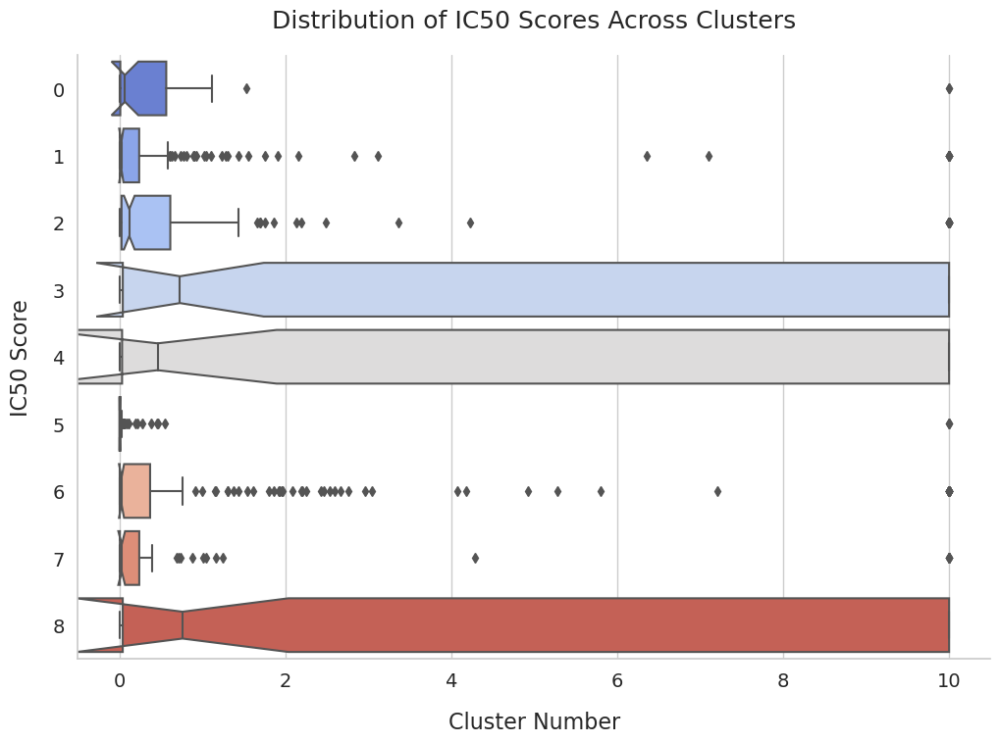

In [31]:
# Merge antibody_cluster_df with ic50_df to get IC50 scores for each antibody
merged_df = pd.merge(antibody_cluster_df, ic50_df[['antibody', 'IC50']], 
                     left_on='Antibody', right_on='antibody', how='left').drop(columns=['antibody'])

# Rename the IC50_Score column to IC_50
merged_df.rename(columns={'IC50': 'IC_50'}, inplace=True)

# Now, merged_df should contain the cluster, antibody name, and corresponding IC_50 scores for each antibody
print("Updated Antibody-Cluster-IC50 Mapping:")
print(merged_df)

import seaborn as sns
import matplotlib.pyplot as plt

# Set the overall aesthetic.
sns.set(style="whitegrid")

plt.figure(figsize=(12, 8))

# Create the boxplot with custom colors
sns.boxplot(x='IC_50', y='Cluster', data=merged_df, palette="coolwarm", orient="h", notch=True)

# Remove the top and right spines for cleanliness
sns.despine(top=True, right=True, left=False, bottom=False)

# Add labels and title
plt.xlabel('Cluster Number', fontsize=16, labelpad=15)
plt.ylabel('IC50 Score', fontsize=16, labelpad=15)
plt.title('Distribution of IC50 Scores Across Clusters', fontsize=18, pad=20)

# Customize tick labels
plt.tick_params(labelsize=14)

# Show the plot
plt.show()


# IC50 Scores vs Cluster Trajectories

## Cluster 1
- **IC50:** Wide range but generally higher values
- **Trajectory:** Very low mean escape (stable)
- **Relation:** Higher IC50 scores may correlate with greater stability over time.

## Cluster 2
- **IC50:** very very low, almost all 0, some outliers.
- **Trajectory:** Low escape initially but a sudden increase
- **Relation:** The low IC50 scores may hint at some form of instability or unique behavior that creates a sudden escape increase.

## Cluster 3
- **IC50:** Wide range
- **Trajectory:** Variable
- **Relation:** The different IC50 scores and changing escape rates show that this group has a mix of antibodies that work well and not so well, and their performance can change over time.

## Cluster 4
- **IC50:** Wide range
- **Trajectory:** Slow and steady increase
- **Relation:** Despite the variability in efficacy (as indicated by IC50), these antibodies have moderate stability over time.

## Cluster 5
- **IC50:** Generally lower (more effective)
- **Trajectory:** Complex but high mean escape by 3 years
- **Relation:** Lower IC50 doesn’t guarantee long-term stability; these antibodies become less effective over time.

## Cluster 6
- **IC50:** Generally lower
- **Trajectory:** High mean escape at 2-2.2 years

## Cluster 7
- **IC50:** Generally lower
- **Trajectory:** Slow but significant increase
- **Relation:** Effective but not stable over time.

## Cluster 8
- **IC50:** Generally lower
- **Trajectory:** Variable
- **Relation:** Again, low IC50 doesn’t guarantee stability.

## Cluster 9
- **IC50:** Generally lower
- **Trajectory:** Moderate increase
- **Relation:** Having a low IC50 and moderate stability means that this group of antibodies might work well for a longer time compared to others.

## Cluster 10
- **IC50:** Generally lower
- **Trajectory:** Highly variable
- **Relation:** While initially effective, these antibodies have a highly unstable pattern over time.

# Conclusions:
- **No Direct Correlation:** Lower IC50 scores don’t always correlate with better long-term stability (mean escape).
- **Anomalies Need Investigation:** Cluster 2 with the lowest IC50s and a high escape after 2 years.
- **Variability:** Clusters with a wide range of IC50 values often show greater variability in their mean escape trajectories as well (e.g., Cluster 3).
- **Trade-offs:** Some clusters may offer a better balance between initial efficacy (lower IC50) and longer-term stability (e.g., Cluster 9).



## Visualizing Antibody Group Density Across Clusters

In this section, we aim to visualize the distribution and density of different antibody groups across the clusters identified previously.

The steps are as follows:

1. **Data organization**: Group the pivoted data based on the cluster and antibody group.
2. **Normalization**: Normalize the grouped data to get the fraction of each antibody group in every cluster.
3. **Heatmap Generation**: Create a cluster map (a type of heatmap) to visually represent the density of each antibody group across clusters.


### Data organization 
First, let's organize the data to get a count of each antibody group in every cluster. The count is then converted to percentages for easier interpretation.

In [32]:
# Create a new dataframe to hold cluster vs ab_group counts
cluster_ab_group_df = pivot_df.groupby(['cluster', 'ab_group']).size().unstack(fill_value=0)

# Normalize the counts to represent fractions within each cluster
cluster_ab_group_df = cluster_ab_group_df.div(cluster_ab_group_df.sum(axis=1), axis=0)

# Convert fractions to percentages
cluster_ab_group_df = cluster_ab_group_df * 100

### Generating the Cluster Map
Using Seaborn's `clustermap` function, we'll visualize the density of each antibody group across different clusters. The color gradient (from white to black) indicates the density percentage.


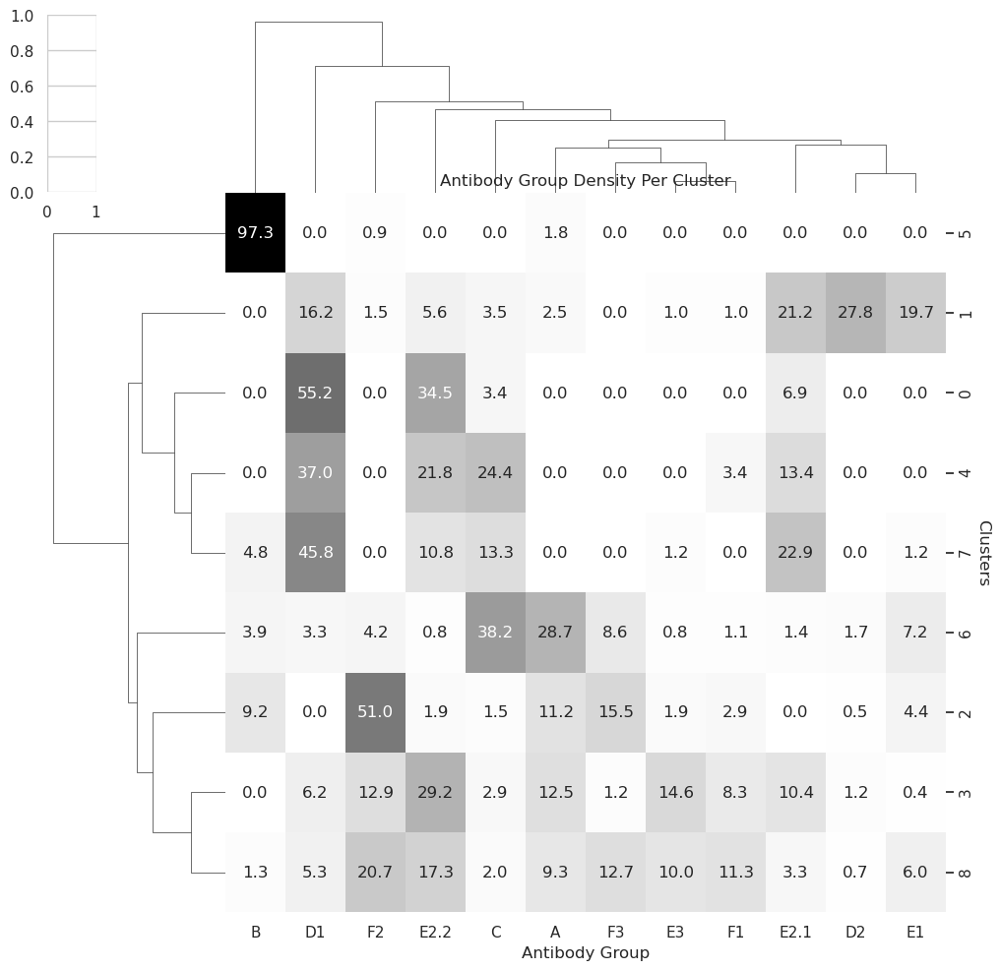

In [33]:
# Making a color gradient
cmap = colors.LinearSegmentedColormap.from_list("mycmap", ["white", "black"])

# Initializing the ClusterMap
g = sns.clustermap(cluster_ab_group_df, annot=True, fmt=".1f", row_cluster=True, col_cluster=True, cmap=cmap, cbar=False)

# Making x-axis label on bottom
g.ax_heatmap.set_xlabel('Antibody Group') 

# Making y-axis label on the right
g.ax_heatmap.set_ylabel('Clusters', rotation=-90, va="baseline")

# Setting the title for the clustermap
g.ax_heatmap.set_title('Antibody Group Density Per Cluster')

plt.show()


## What to deduce from the cluster map
* Antibody group B, has high density in one specific cluster.
* Other antibody groups are widely spread, displaying varying density levels across clusters.
* Antibody group D1, E2.2, and C exhibits higher density levels in multiple clusters.
* Antibody group E2.1 presents a moderate density spread across several clusters.


# Lets dive into the UMAP analysis now

Here, lets color the dots on teh UMAP analysis based on antibody groups

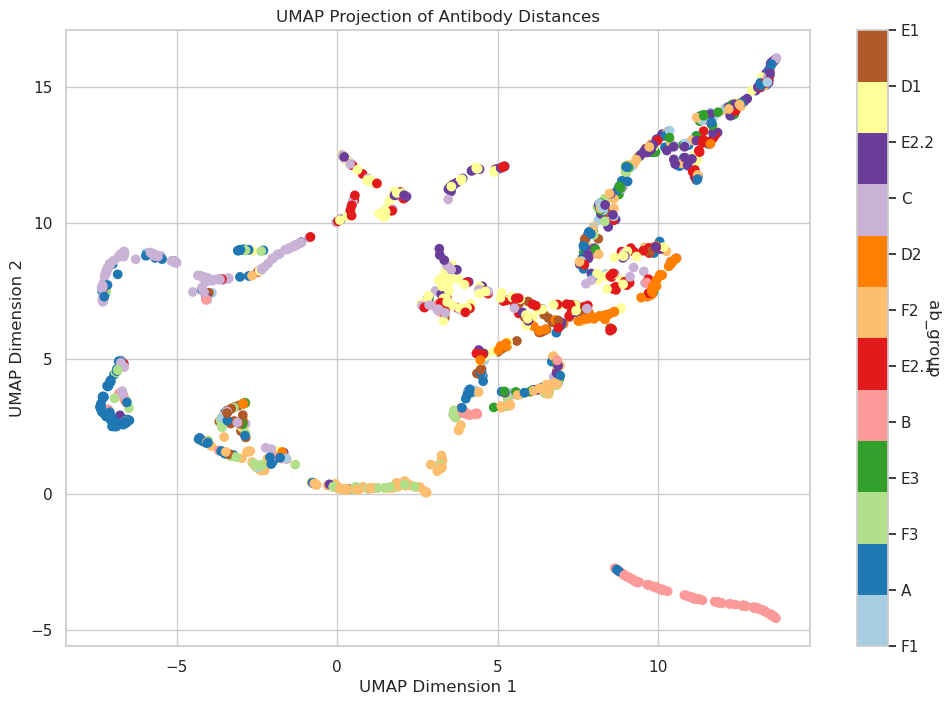

In [34]:
# Here, we are reading the 'distance_matrix.csv' file into a DataFrame.
# The 'index_col=0' argument tells pandas to use the first column of the CSV as the row labels (index) for the DataFrame.
distance_matrix = pd.read_csv('Results/distance_matrix.csv', index_col=0)

# Ensuring that the entire DataFrame consists of floating point numbers. This is important for math operations
# and compatibility with many algorithms like UMAP.
distance_matrix = distance_matrix.astype(float)

# Create a dictionary that maps each antibody to its respective 'ab_group'. This will be useful for coloring the points 
# in our scatter plot later on. The 'zip' function pairs up elements from two lists into tuples.
ab_to_group_dict = dict(zip(ab_window_data['antibody'], ab_window_data['ab_group']))

# Now, we map the antibodies in the 'distance_matrix' to their corresponding 'ab_group' using the dictionary created above.
# If an antibody isn't found in our dictionary, it's labeled as 'Unknown'.
colors = [ab_to_group_dict.get(ab, 'Unknown') for ab in distance_matrix.index]

# Extract the unique 'ab_group' labels. We'll use these for creating a color palette for our scatter plot.
unique_ab_groups = list(set(colors))

# Create a dictionary that maps each 'ab_group' to a unique index. This index will correspond to a color 
# when plotting.
color_map = {ab_group: idx for idx, ab_group in enumerate(unique_ab_groups)}

# Map each antibody in the 'colors' list to its respective color index.
colors = [color_map[ab_group] for ab_group in colors]

# Initialize a UMAP model. The 'metric=precomputed' argument is essential because we're using a precomputed distance matrix.
umap_model = umap.UMAP(random_state=42)

# Fit the UMAP model to the distance matrix and get the reduced dimensional representation. In this case, 
# the high-dimensional data gets transformed into 2D coordinates.
embedding = umap_model.fit_transform(distance_matrix)

# Split the 2D coordinates into x and y for plotting.
x_coords = embedding[:, 0]
y_coords = embedding[:, 1]

# Set up a figure with a specific size for our scatter plot.
plt.figure(figsize=(12, 8))

# Create the scatter plot. Each point's color is determined by its 'ab_group'. The 'cmap' argument specifies 
# a colormap which is a range of colors used in the plot.
sc = plt.scatter(x_coords, y_coords, c=colors, cmap=plt.cm.get_cmap('Paired', len(unique_ab_groups)))

# Add a color bar to the plot that shows the color corresponding to each 'ab_group'.
cbar = plt.colorbar(sc, ticks=range(len(unique_ab_groups)))
cbar.set_label('ab_group', rotation=270)  # Set the label for the color bar.
cbar.set_ticklabels(unique_ab_groups)  # Label each tick in the color bar with the 'ab_group' name.

# Label the x and y axes, and set a title for the scatter plot.
plt.xlabel('UMAP Dimension 1')
plt.ylabel('UMAP Dimension 2')
plt.title('UMAP Projection of Antibody Distances')

# Display the scatter plot.

plt.show()

In [35]:
######NEW 

# Create a new DataFrame from the embedding. This DataFrame will have the x and y coordinates.
embedding_df = pd.DataFrame(embedding, columns=['UMAP Dimension 1', 'UMAP Dimension 2'])

# Now, add the antibody names from the original distance matrix. We assume here that the index of 'distance_matrix'
# contains the antibody names, as suggested by your code for creating the 'colors' list.
embedding_df['antibody'] = distance_matrix.index
print(embedding_df)
# At this point, 'embedding_df' is a DataFrame where each row contains the UMAP coordinates for an antibody, along with
# the name of the antibody. You can use this for a labeled scatter plot, for example.
# Filter the DataFrame to only include rows where 'UMAP Dimension 1' > 10 and 'UMAP Dimension 2' > 7.
filtered_df = embedding_df[(embedding_df['UMAP Dimension 1'] < -6) & (embedding_df['UMAP Dimension 2'] > 2)]

# Extract the 'antibody' column from the filtered DataFrame. This column contains the names of the antibodies

antibodies_list = filtered_df['antibody'].tolist()
embedding_df.head()

      UMAP Dimension 1  UMAP Dimension 2 antibody
0             8.650199          6.723126     1-57
1            -5.485366          8.781423     2-15
2            -6.660073          8.920135      7D6
3            -2.323516          1.005379    ADG-2
4            -5.070700          8.593060      B38
...                ...               ...      ...
1492          8.944903         -2.979460  XGv-409
1493          4.463017          4.586443  XGv-412
1494         -2.706911          1.590427  XGv-416
1495          7.439148          6.767323  XGv-420
1496         -3.429959          2.987979  XGv-421

[1497 rows x 3 columns]


,UMAP Dimension 1,UMAP Dimension 2,antibody
0,8.650199,6.723126,1-57
1,-5.485366,8.781423,2-15
2,-6.660073,8.920135,7D6
3,-2.323516,1.005379,ADG-2
4,-5.070700,8.593060,B38


In [36]:
###ALSO NEW 
embedding_df.to_csv('Results/embedding_df')
filtered_df.to_csv('Results/filtered_df.csv')


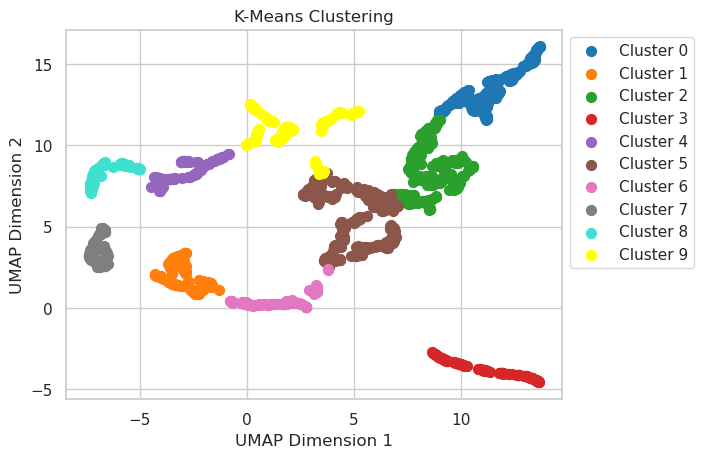

   Unnamed: 0  UMAP Dimension 1  UMAP Dimension 2 antibody  Cluster
0           0          8.650199          6.723126     1-57        2
1           1         -5.485366          8.781423     2-15        8
2           2         -6.660073          8.920135      7D6        8
3           3         -2.323516          1.005379    ADG-2        1
4           4         -5.070700          8.593060      B38        8


In [37]:
import pandas as pd
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Load and display the CSV file
#file_path = 'embedding_df.csv'  
df = pd.read_csv('Results/embedding_df')

#print(df.head())  # display first few rows of the dataframe

# Selecting the number of clusters
num_clusters = 10  # or another appropriate number based on your data

# Extracting the relevant dimensions
X = df[['UMAP Dimension 1', 'UMAP Dimension 2']]

# Running k-means clustering
kmeans = KMeans(n_clusters=num_clusters, random_state=0).fit(X)
df['Cluster'] = kmeans.labels_


colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f','#40E0D0','#FFFF00',"#FF5733"] 

# Create a scatter plot
fig, ax = plt.subplots()

for i in range(num_clusters):
    points = df[df['Cluster'] == i]
    ax.scatter(points['UMAP Dimension 1'], points['UMAP Dimension 2'], s=50, c=colors[i], label=f'Cluster {i}')  # colors[i] now refers to a hex color

ax.set_title('K-Means Clustering')
ax.set_xlabel('UMAP Dimension 1')
ax.set_ylabel('UMAP Dimension 2')
ax.legend(bbox_to_anchor = [1,1])

plt.show()

# Save to a new CSV
df.to_csv('Results/embedding_df_with_clusters.csv', index=False)

# Or display the DataFrame
print(df.head())



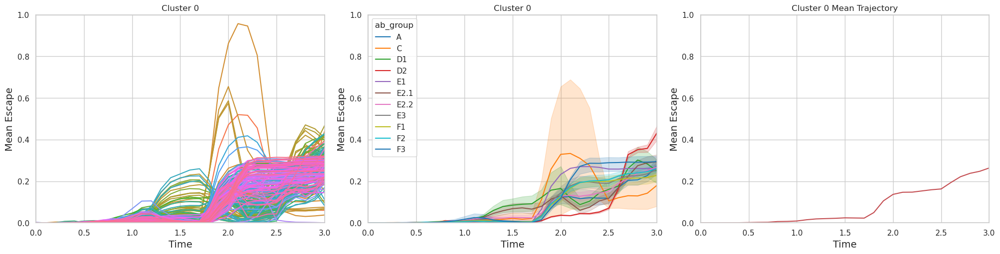

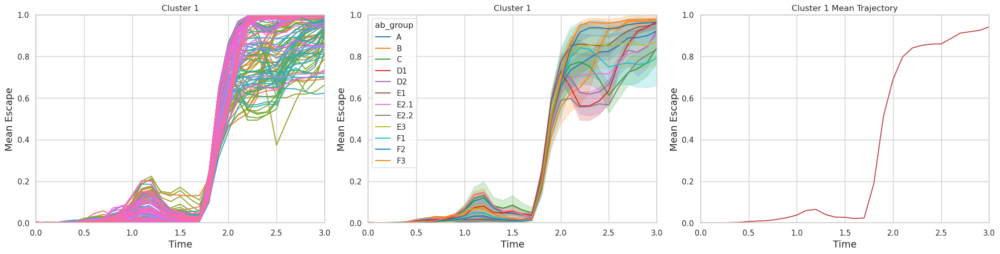

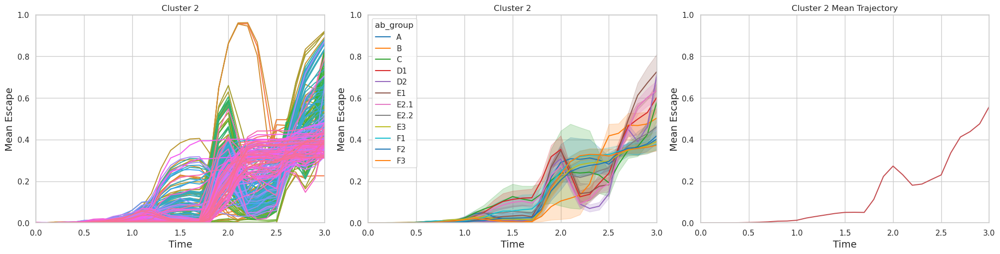

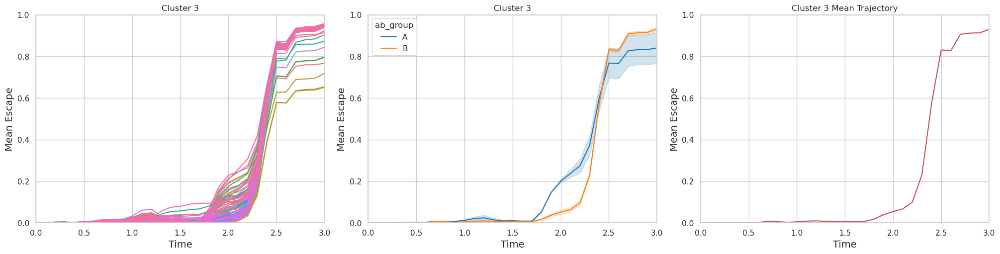

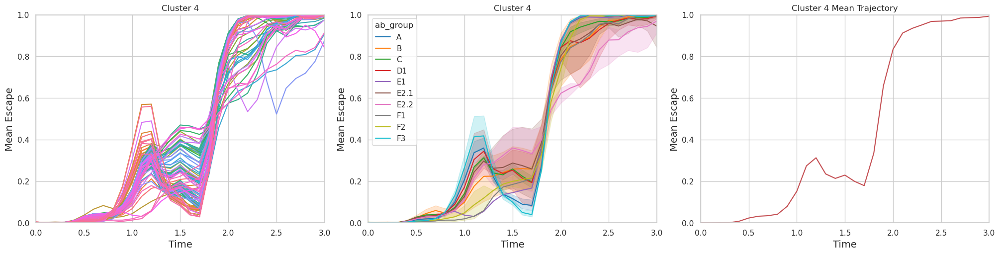

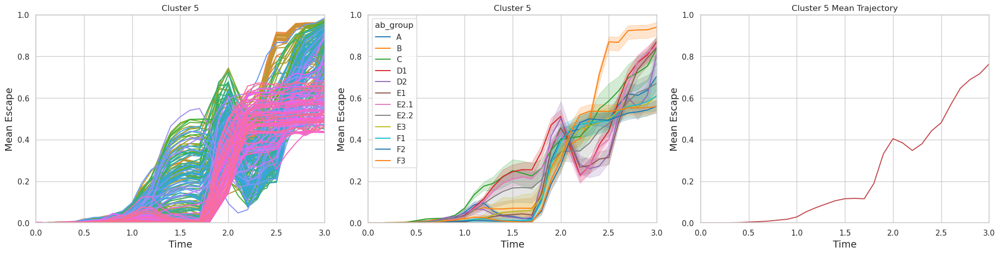

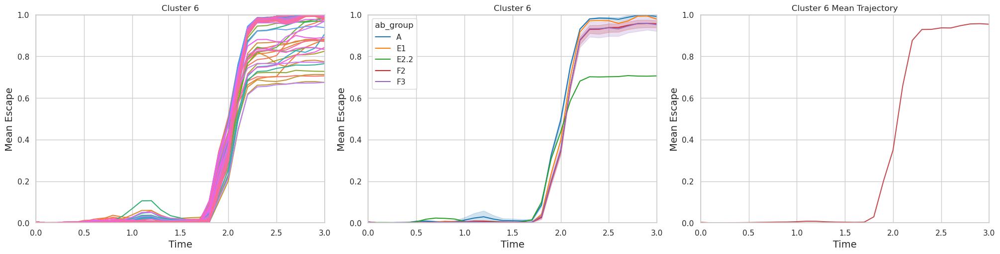

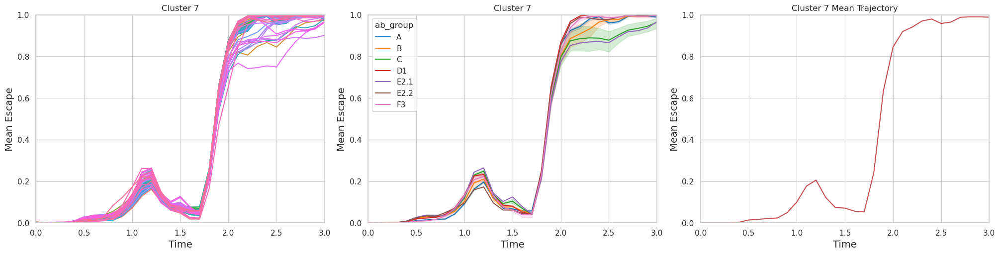

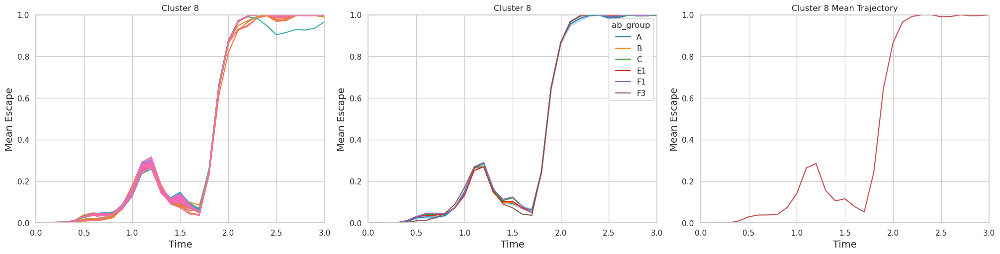

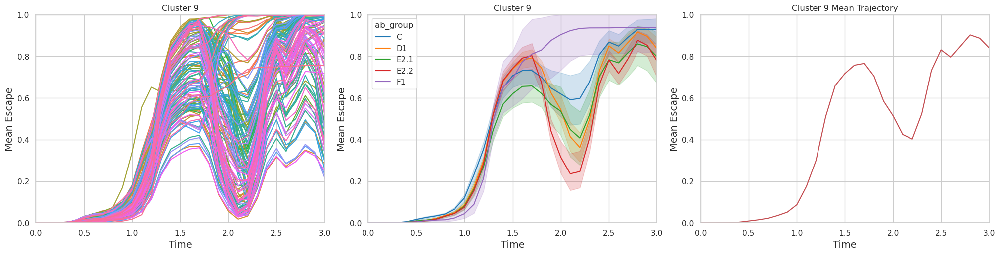

In [38]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt


cluster_info = df #df is in teh previous plot, its the embedding_df_with_clusters.csv file lol

# Merge the dataframes on the 'antibody' column
merged_data = pd.merge(ab_window_data, cluster_info, on='antibody')


# Define the number of clusters
num_clusters = 10

for cluster in range(num_clusters):
    # Filter the data for the current cluster
    cluster_df = merged_data[merged_data['Cluster'] == cluster]

    if not cluster_df.empty:
        # Initialize a grid of 3 horizontal plots
        fig, axs = plt.subplots(1, 3, figsize=(20, 5), constrained_layout=True)
        
        # Normal plot with all antibodies in the cluster
        sns.lineplot(data=cluster_df, x='time', y='mean_escape', hue='antibody', ax=axs[0], legend=False)
        axs[0].set_title(f'Cluster {cluster}')
        axs[0].set_xlabel('Time', fontsize=14)
        axs[0].set_ylabel('Mean Escape', fontsize=14)

        # Plot classified by antibody group
        sns.lineplot(data=cluster_df, x='time', y='mean_escape', hue='ab_group', palette='tab10', ax=axs[1])
        axs[1].set_title(f'Cluster {cluster}')
        axs[1].set_xlabel('Time', fontsize=14)
        axs[1].set_ylabel('Mean Escape', fontsize=14)

        # Plot displaying mean trajectory
        sns.lineplot(data=cluster_df, x='time', y='mean_escape', ci=None, estimator=np.mean, color='r', ax=axs[2])
        axs[2].set_title(f'Cluster {cluster} Mean Trajectory')
        axs[2].set_xlabel('Time', fontsize=14)
        axs[2].set_ylabel('Mean Escape', fontsize=14)
        
        # set x and y axis limits (adjust according to your specific data range)
        for ax in axs:
            ax.set_xlim([0, 3])  
            ax.set_ylim([0, 1])  
        
        # Show the plot
        plt.show()
        

In [39]:
# upper = []
# lower = []
# # Iterating to separate cluster 6 (assuming df is the DataFrame with your data)
# for index, row in cluster6.iterrows():
#     if row['mean_escape'] > 0.44 and 2.15 < row['time'] < 2.25:
#         upper.append(row['antibody'])
#     else:
#         lower.append(row['antibody'])

# clusters = 2
        
# for i in range(clusters):
#     # Filter the data for the current cluster
#     if i == 0:
#         cluster_df = cluster6[cluster6['antibody'].isin(upper)]
#     else:
#         cluster_df = cluster6[cluster6['antibody'].isin(lower)]

#     if not cluster_df.empty:
#         # Initialize a grid of 3 horizontal plots
#         fig, axs = plt.subplots(1, 3, figsize=(20, 5), constrained_layout=True)
        
#         # Normal plot with all antibodies in the cluster
#         sns.lineplot(data=cluster_df, x='time', y='mean_escape', hue='antibody', ax=axs[0], legend=False)
#         axs[0].set_title(f'Cluster {i}')
#         axs[0].set_xlabel('Time', fontsize=14)
#         axs[0].set_ylabel('Mean Escape', fontsize=14)

#         # Plot classified by antibody group
#         sns.lineplot(data=cluster_df, x='time', y='mean_escape', hue='ab_group', palette='tab10', ax=axs[1])
#         axs[1].set_title(f'Cluster {i}')
#         axs[1].set_xlabel('Time', fontsize=14)
#         axs[1].set_ylabel('Mean Escape', fontsize=14)

#         # Plot displaying mean trajectory
#         sns.lineplot(data=cluster_df, x='time', y='mean_escape', ci=None, estimator=np.mean, color='r', ax=axs[2])
#         axs[2].set_title(f'Cluster {i} Mean Trajectory')
#         axs[2].set_xlabel('Time', fontsize=14)
#         axs[2].set_ylabel('Mean Escape', fontsize=14)
        
#         # Set x and y axis limits (adjust according to your specific data range)
#         for ax in axs:
#             ax.set_xlim([df['time'].min(), df['time'].max()])
#             ax.set_ylim([df['mean_escape'].min(), df['mean_escape'].max()])
        
#         # Show the plot
#         plt.show()

        

In [40]:
print(ab_window_data)


      antibody  n_disallowed_aa_substitutions  mean_escape  time ab_group
0          B38                       0.337963     0.000000   0.0        A
1       BD-218                       0.337963     0.000000   0.0        A
2       BD-236                       0.337963     0.000000   0.0        A
3       BD-369                       0.337963     0.000000   0.0        A
4       BD-395                       0.337963     0.000000   0.0        A
...        ...                            ...          ...   ...      ...
97225   DH1183                      36.546875     1.000000   3.4       F3
97226    S2H14                      39.437500     1.000000   3.4       F3
97227    S2X35                      40.531250     0.433031   3.4       F3
97228  XGv-116                      38.562500     0.998528   3.4       F3
97229  XGv-360                      39.421875     1.000000   3.4       F3

[97230 rows x 5 columns]


## UMAP Antibody Group Analysis Take Aways
* we see alot of correspondance, in terms of antibody groups sticking together
* what we dont see here though is isolation, alot of antibody groups are stacked ontop of eachother, meaning alor of grouping together beween differnt antibody groups

Here, lets color the dots on teh UMAP analysis based on clusters that the antibodies correspond to

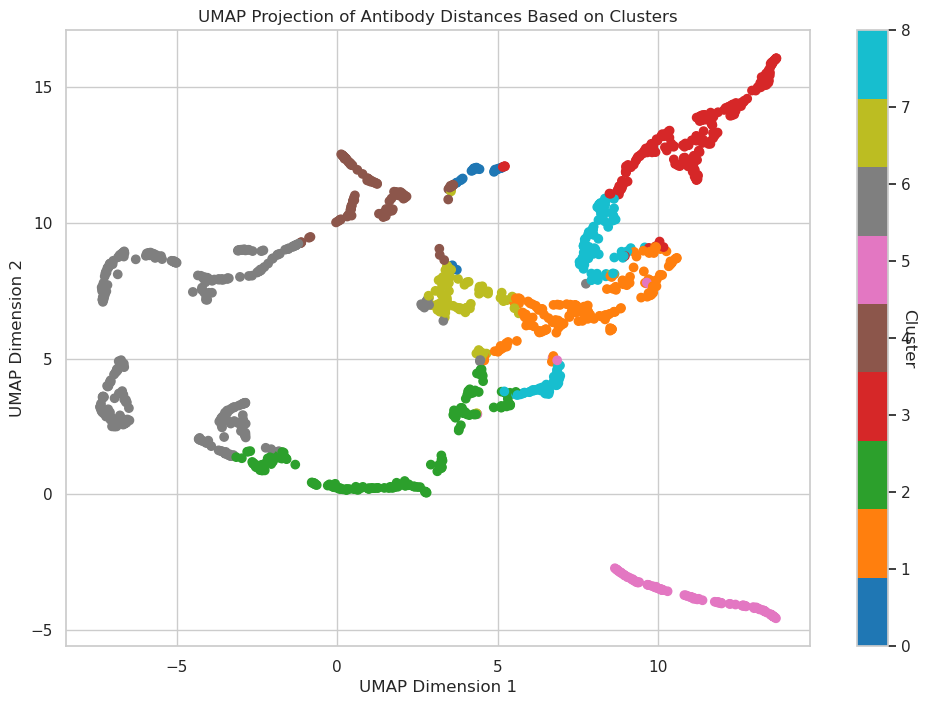

In [41]:
# Here, we read the 'distance_matrix.csv' file into a DataFrame.
# The 'index_col=0' argument tells pandas to use the first column of the CSV as the row labels (index) for the DataFrame.
distance_matrix = pd.read_csv('Results/distance_matrix.csv', index_col=0)

# We're also reading another dataset 'antibody_cluster_df.csv' which contains information about the cluster
# each antibody belongs to.
antibody_cluster_df = pd.read_csv('Results/antibody_cluster_df.csv')

# Ensuring that the distance matrix consists of floating point numbers, making it compatible for mathematical operations
# and many algorithms like UMAP.
distance_matrix = distance_matrix.astype(float)

# Creating a dictionary that maps each antibody name to its respective cluster. 
# The 'zip' function pairs up elements from two columns of the dataframe into tuples.
ab_to_cluster_dict = dict(zip(antibody_cluster_df['Antibody'], antibody_cluster_df['Cluster']))

# Now, we associate the antibodies in the 'distance_matrix' with their respective cluster using the above dictionary.
# If an antibody is not found in our dictionary, it gets labeled as 'Unknown'.
colors = [ab_to_cluster_dict.get(ab, 'Unknown') for ab in distance_matrix.index]

# Extract the unique cluster labels. These will be used for creating a color palette for our scatter plot.
unique_clusters = list(set(colors))

# Create a dictionary that associates each unique cluster to a unique color index. 
# This index will correspond to a color when plotting.
color_map = {cluster: idx for idx, cluster in enumerate(unique_clusters)}

# Assign a color index to each antibody based on its cluster.
colors = [color_map[cluster] for cluster in colors]

# Initialize the UMAP model.
umap_model = umap.UMAP(random_state=42)

# Apply the UMAP model to the distance matrix and reduce its dimensions.
# The result is a 2D representation of our data.
embedding = umap_model.fit_transform(distance_matrix)

# Extract the x and y coordinates from the 2D representation for plotting purposes.
x_coords = embedding[:, 0]
y_coords = embedding[:, 1]

# Set up the plotting canvas with specified dimensions.
plt.figure(figsize=(12, 8))

# Plot the 2D representation. The color of each point corresponds to its cluster.
sc = plt.scatter(x_coords, y_coords, c=colors, cmap=plt.cm.get_cmap('tab10', len(unique_clusters)))

# Add a color bar to the plot indicating which color corresponds to which cluster.
cbar = plt.colorbar(sc, ticks=range(len(unique_clusters)))
cbar.set_label('Cluster', rotation=270)
cbar.set_ticklabels(unique_clusters)

# Label the axes and give the plot a title.
plt.xlabel('UMAP Dimension 1')
plt.ylabel('UMAP Dimension 2')
plt.title('UMAP Projection of Antibody Distances Based on Clusters')

# Display the scatter plot.
plt.show()

In [42]:
embedding_df = pd.read_csv('Results/embedding_df')
embedding_df.head()


,Unnamed: 0,UMAP Dimension 1,UMAP Dimension 2,antibody
0,0,8.650199,6.723126,1-57
1,1,-5.485366,8.781423,2-15
2,2,-6.660073,8.920135,7D6
3,3,-2.323516,1.005379,ADG-2
4,4,-5.070700,8.593060,B38


In [43]:
import pandas as pd
from sklearn.cluster import DBSCAN


# You can adjust the parameters of DBSCAN as per your requirement
dbscan = DBSCAN(eps=0.5, min_samples=2, algorithm='ball_tree')
embedding_df['cluster'] = dbscan.fit_predict(embedding_df[['UMAP Dimension 1', 'UMAP Dimension 2']])

embedding_df.tail()


,Unnamed: 0,UMAP Dimension 1,UMAP Dimension 2,antibody,cluster
1492,1492,8.944903,-2.979460,XGv-409,8
1493,1493,4.463017,4.586443,XGv-412,7
1494,1494,-2.706911,1.590427,XGv-416,2
1495,1495,7.439148,6.767323,XGv-420,0
1496,1496,-3.429959,2.987979,XGv-421,6


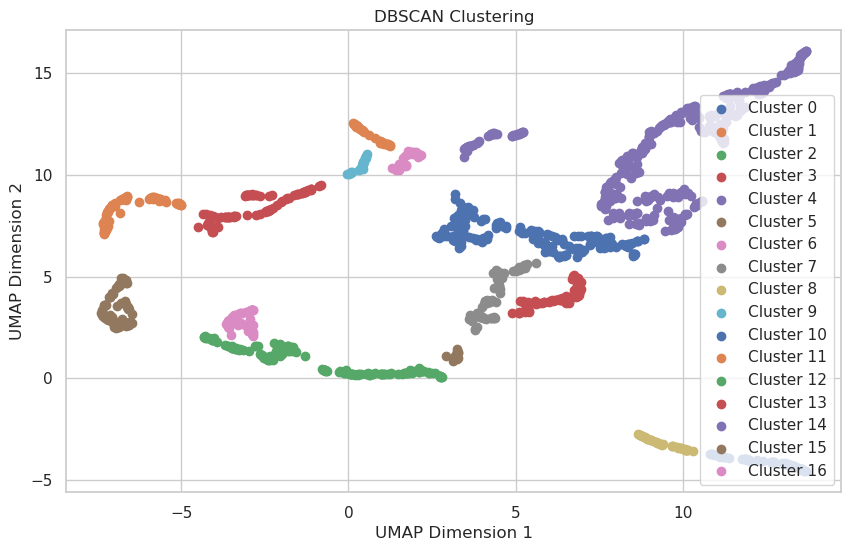

In [44]:
import matplotlib.pyplot as plt

# Sample data and DBSCAN clustering from the previous code
# Using the same embedding_df DataFrame

# Plotting the clusters
plt.figure(figsize=(10, 6))

# Unique cluster labels
unique_clusters = embedding_df['cluster'].unique()

# Plot each cluster with a different color
for cluster in unique_clusters:
    # Select data for each cluster
    cluster_data = embedding_df[embedding_df['cluster'] == cluster]
    
    # Plot the points with different colors
    plt.scatter(cluster_data['UMAP Dimension 1'], cluster_data['UMAP Dimension 2'], label=f'Cluster {cluster}')

plt.title('DBSCAN Clustering')
plt.xlabel('UMAP Dimension 1')
plt.ylabel('UMAP Dimension 2')
plt.legend()
plt.show()

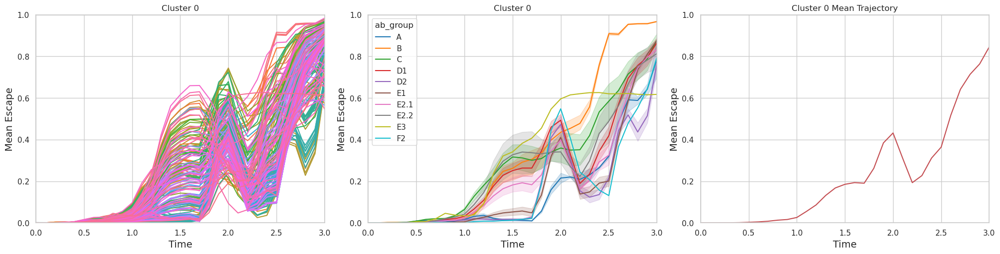

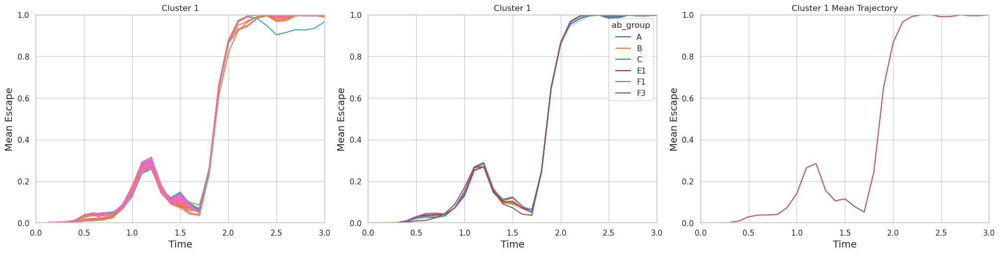

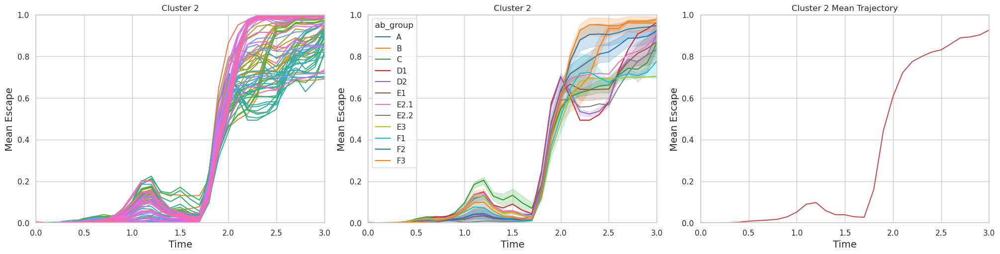

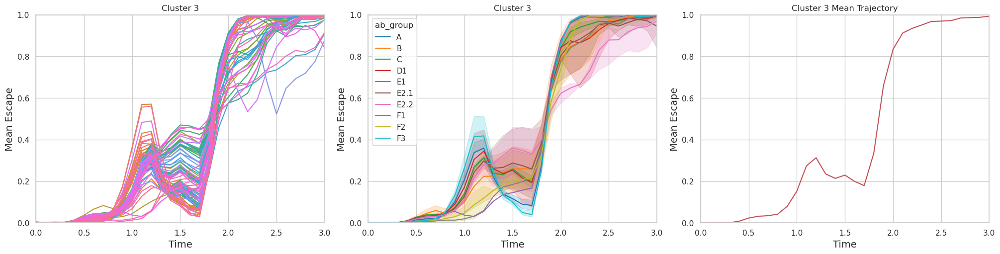

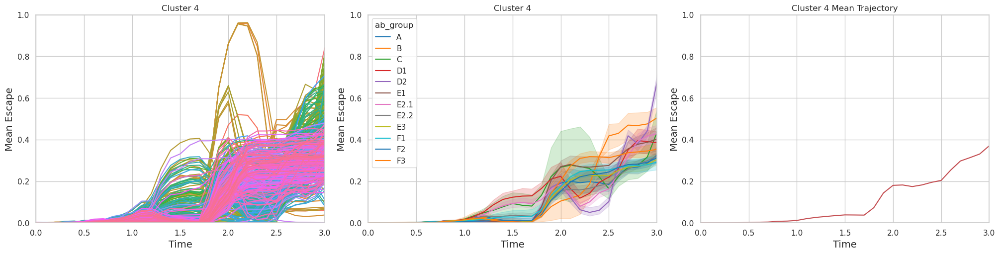

...

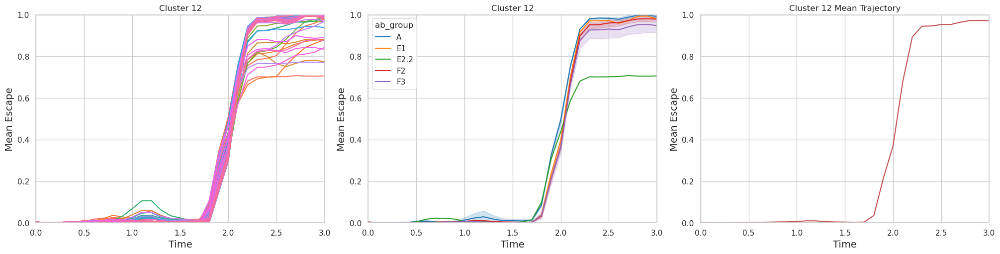

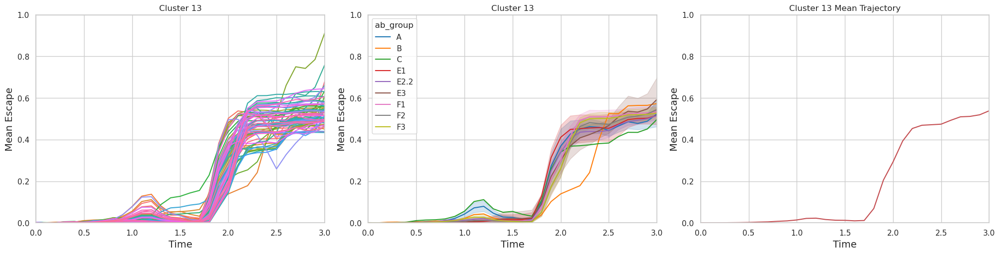

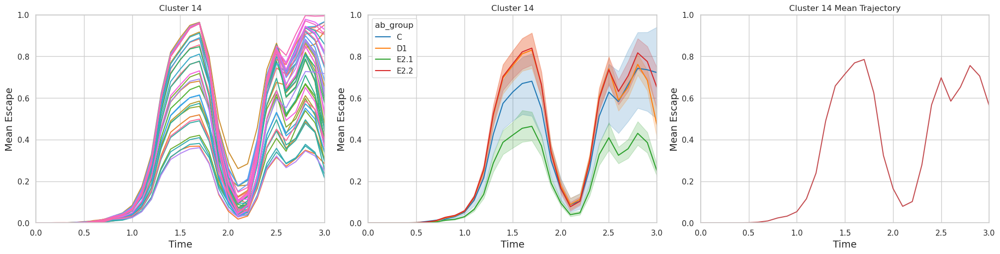

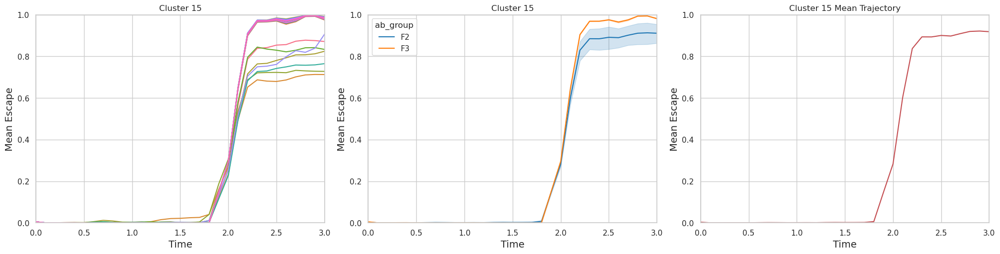

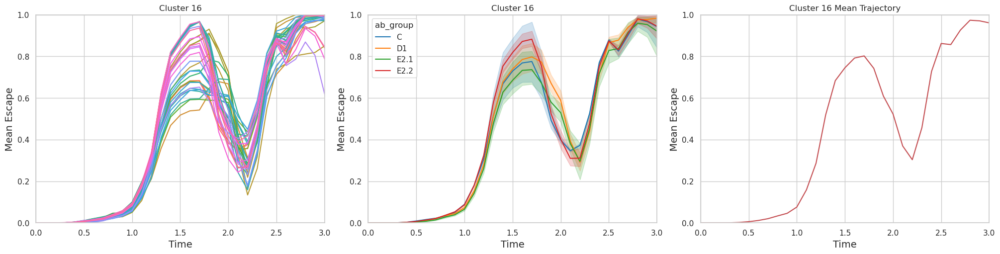

In [45]:
merged_data = pd.merge(ab_window_data, embedding_df, on='antibody')


# Define the number of clusters
num_clusters = embedding_df['cluster'].max() + 1

for cluster in range(num_clusters):
    # Filter the data for the current cluster
    cluster_df = merged_data[merged_data['cluster'] == cluster]

    if not cluster_df.empty:
        # Initialize a grid of 3 horizontal plots
        fig, axs = plt.subplots(1, 3, figsize=(20, 5), constrained_layout=True)
        
        # Normal plot with all antibodies in the cluster
        sns.lineplot(data=cluster_df, x='time', y='mean_escape', hue='antibody', ax=axs[0], legend=False)
        axs[0].set_title(f'Cluster {cluster}')
        axs[0].set_xlabel('Time', fontsize=14)
        axs[0].set_ylabel('Mean Escape', fontsize=14)

        # Plot classified by antibody group
        sns.lineplot(data=cluster_df, x='time', y='mean_escape', hue='ab_group', palette='tab10', ax=axs[1])
        axs[1].set_title(f'Cluster {cluster}')
        axs[1].set_xlabel('Time', fontsize=14)
        axs[1].set_ylabel('Mean Escape', fontsize=14)

        # Plot displaying mean trajectory
        sns.lineplot(data=cluster_df, x='time', y='mean_escape', ci=None, estimator=np.mean, color='r', ax=axs[2])
        axs[2].set_title(f'Cluster {cluster} Mean Trajectory')
        axs[2].set_xlabel('Time', fontsize=14)
        axs[2].set_ylabel('Mean Escape', fontsize=14)
        
        # set x and y axis limits (adjust according to your specific data range)
        for ax in axs:
            ax.set_xlim([0, 3])  
            ax.set_ylim([0, 1])  
        
        # Show the plot
        plt.show()
        

In [46]:
#HDBSCAN INSTEAD 
#!pip install hdbscan

In [47]:
import hdbscan

clusterer = hdbscan.HDBSCAN(
    min_cluster_size=30,  # Try lowering this to include smaller clusters
    min_samples=2,       # Try decreasing this to make it easier for points to be considered core points
    cluster_selection_epsilon=0.1,  # Try increasing this to merge close clusters
    
)

embedding_df['cluster'] = clusterer.fit_predict(embedding_df[['UMAP Dimension 1', 'UMAP Dimension 2']])


# Show the tail of the DataFrame to see the assigned clusters
embedding_df.tail()


,Unnamed: 0,UMAP Dimension 1,UMAP Dimension 2,antibody,cluster
1492,1492,8.944903,-2.979460,XGv-409,0
1493,1493,4.463017,4.586443,XGv-412,13
1494,1494,-2.706911,1.590427,XGv-416,15
1495,1495,7.439148,6.767323,XGv-420,20
1496,1496,-3.429959,2.987979,XGv-421,7


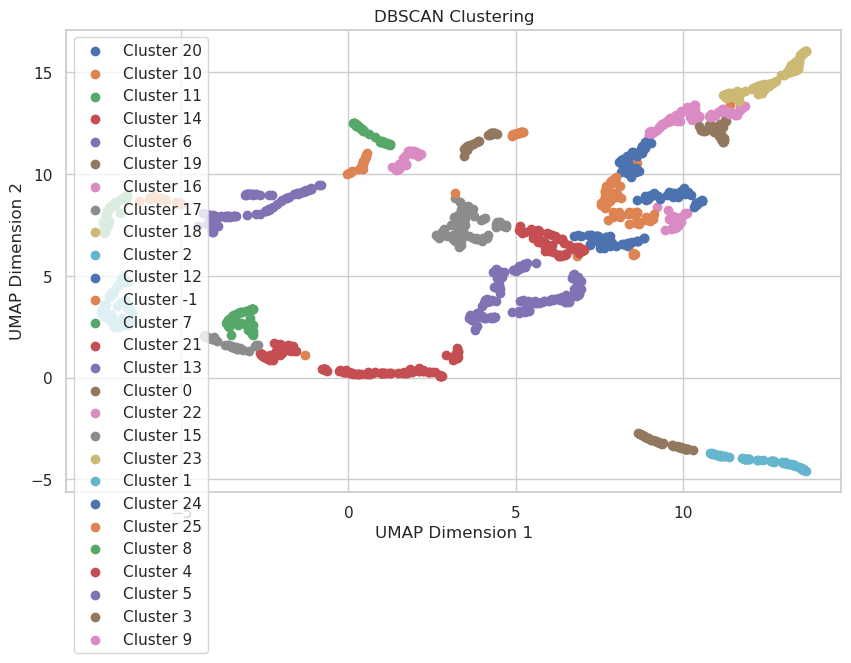

In [48]:
import matplotlib.pyplot as plt

# Sample data and DBSCAN clustering from the previous code
# Using the same embedding_df DataFrame

# Plotting the clusters
plt.figure(figsize=(10, 6))

# Unique cluster labels
unique_clusters = embedding_df['cluster'].unique()

# Plot each cluster with a different color
for cluster in unique_clusters:
    # Select data for each cluster
    cluster_data = embedding_df[embedding_df['cluster'] == cluster]
    
    # Plot the points with different colors
    plt.scatter(cluster_data['UMAP Dimension 1'], cluster_data['UMAP Dimension 2'], label=f'Cluster {cluster}')

plt.title('DBSCAN Clustering')
plt.xlabel('UMAP Dimension 1')
plt.ylabel('UMAP Dimension 2')
plt.legend()
plt.show()

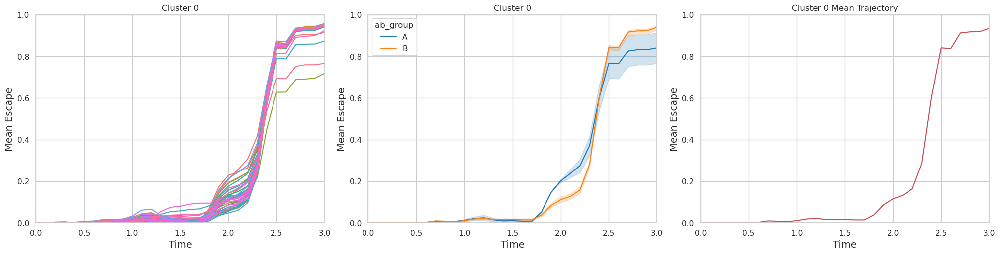

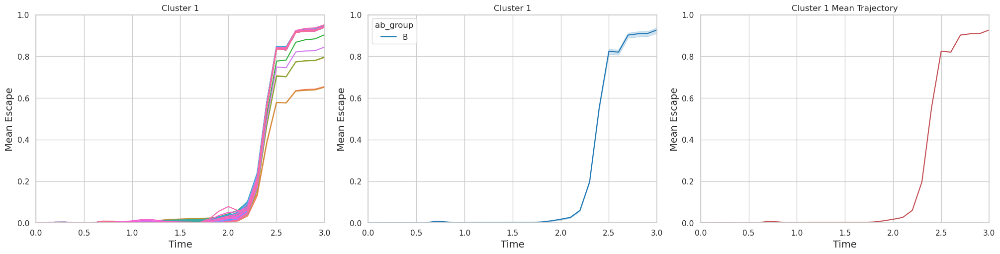

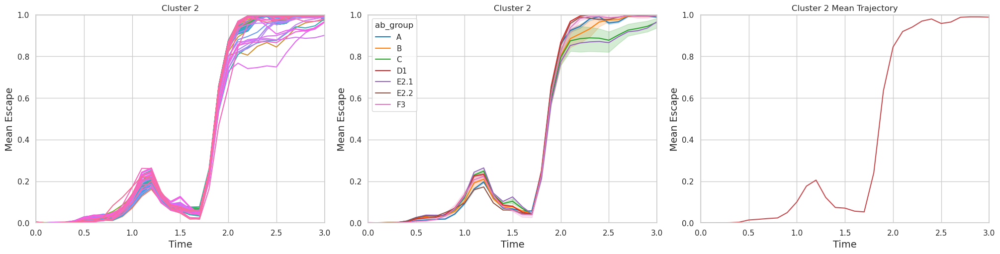

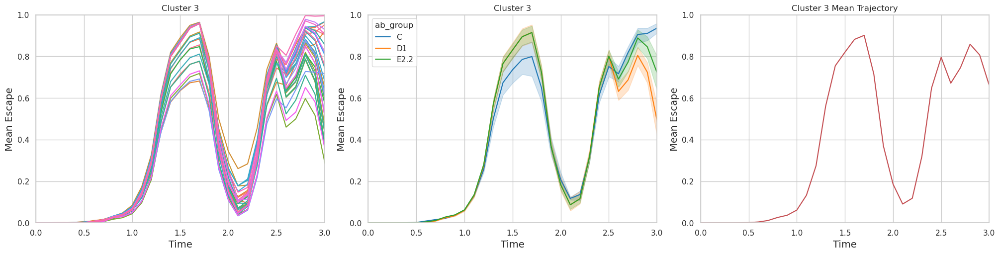

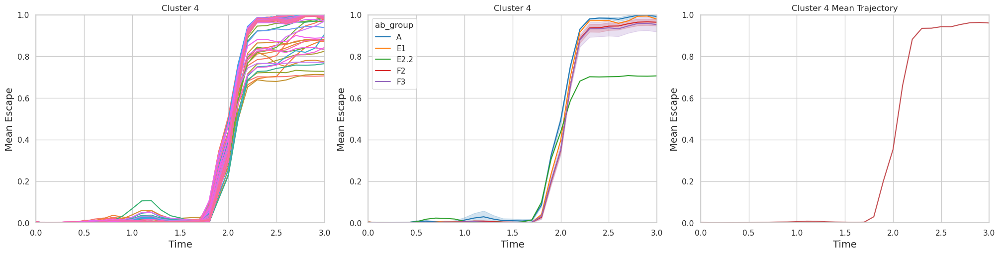

...

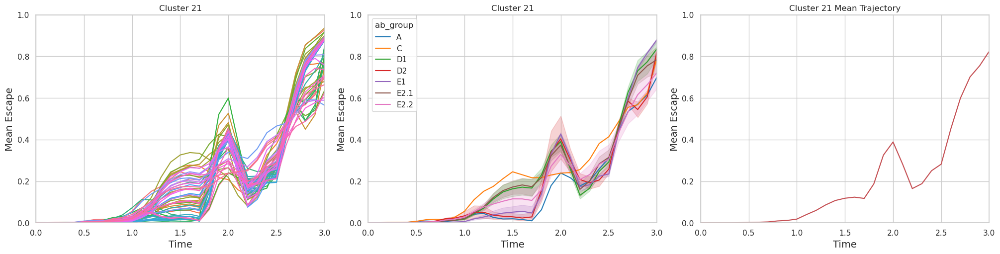

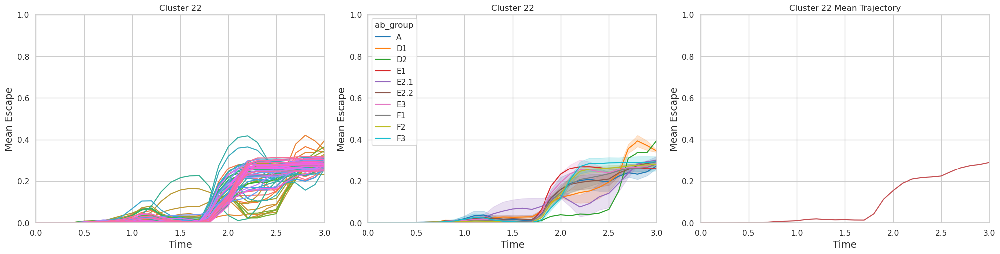

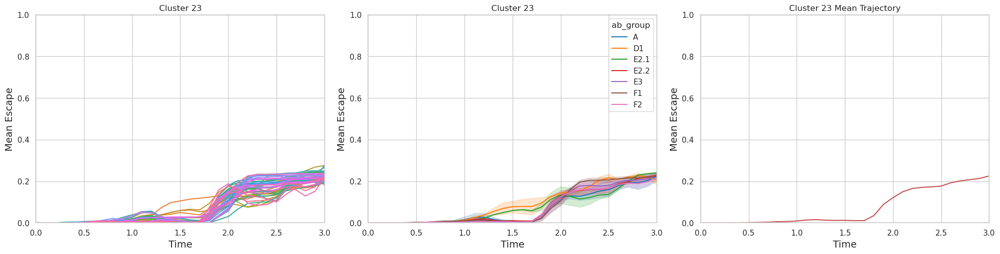

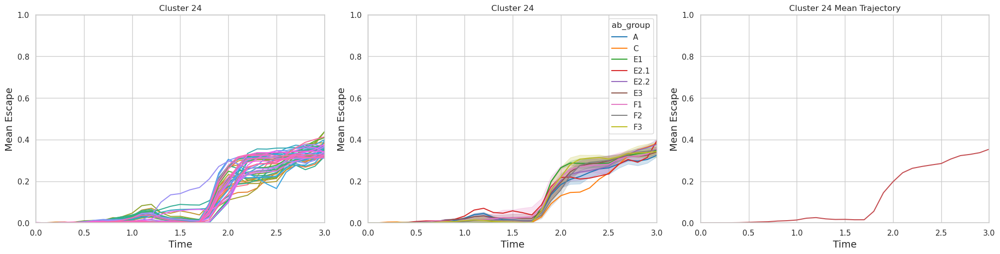

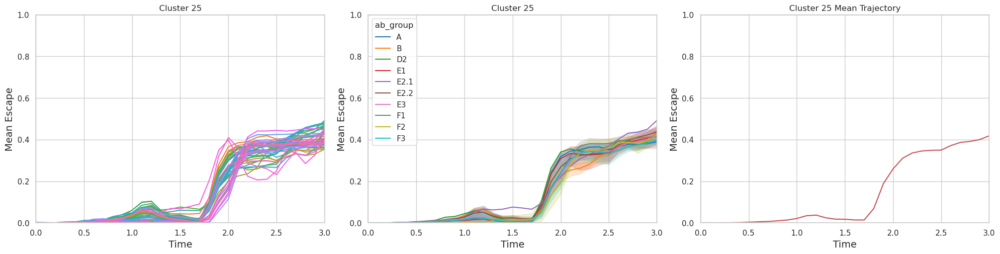

In [49]:
merged_data = pd.merge(ab_window_data, embedding_df, on='antibody')


# Define the number of clusters
num_clusters =embedding_df['cluster'].max() + 1


for cluster in range(num_clusters):
    # Filter the data for the current cluster
    cluster_df = merged_data[merged_data['cluster'] == cluster]

    if not cluster_df.empty:
        # Initialize a grid of 3 horizontal plots
        fig, axs = plt.subplots(1, 3, figsize=(20, 5), constrained_layout=True)
        
        # Normal plot with all antibodies in the cluster
        sns.lineplot(data=cluster_df, x='time', y='mean_escape', hue='antibody', ax=axs[0], legend=False)
        axs[0].set_title(f'Cluster {cluster}')
        axs[0].set_xlabel('Time', fontsize=14)
        axs[0].set_ylabel('Mean Escape', fontsize=14)

        # Plot classified by antibody group
        sns.lineplot(data=cluster_df, x='time', y='mean_escape', hue='ab_group', palette='tab10', ax=axs[1])
        axs[1].set_title(f'Cluster {cluster}')
        axs[1].set_xlabel('Time', fontsize=14)
        axs[1].set_ylabel('Mean Escape', fontsize=14)

        # Plot displaying mean trajectory
        sns.lineplot(data=cluster_df, x='time', y='mean_escape', ci=None, estimator=np.mean, color='r', ax=axs[2])
        axs[2].set_title(f'Cluster {cluster} Mean Trajectory')
        axs[2].set_xlabel('Time', fontsize=14)
        axs[2].set_ylabel('Mean Escape', fontsize=14)
        
        # set x and y axis limits (adjust according to your specific data range)
        for ax in axs:
            ax.set_xlim([0, 3])  
            ax.set_ylim([0, 1])  
        
        # Show the plot
        plt.show()
        

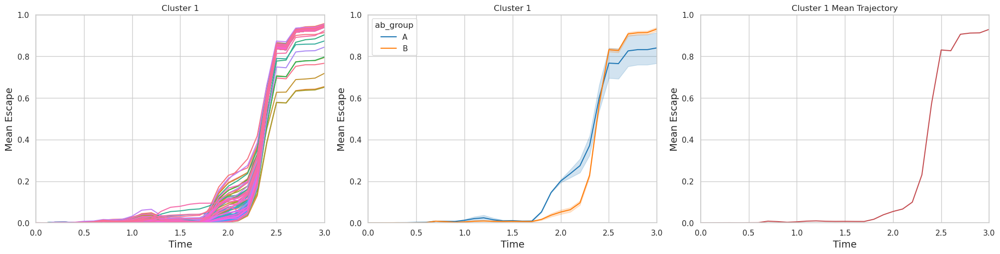

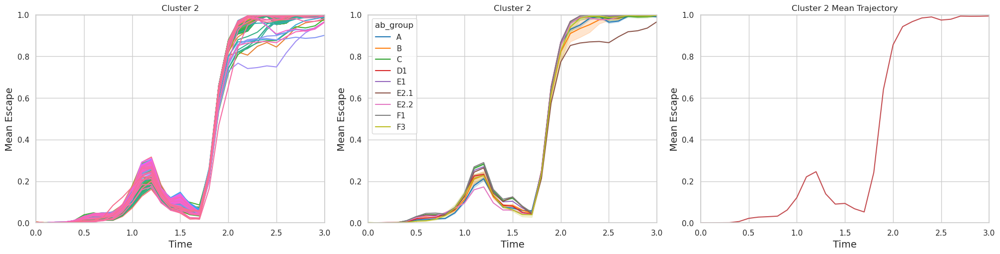

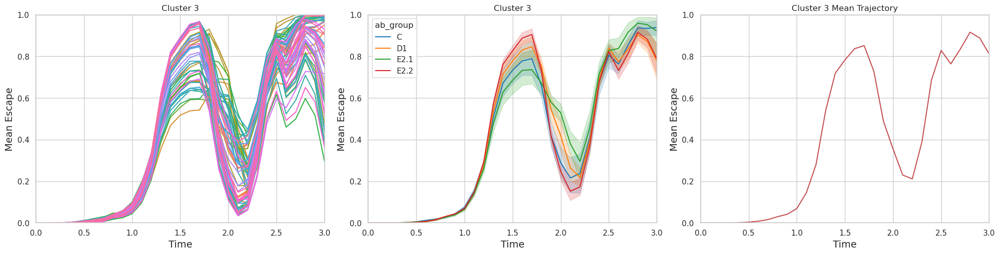

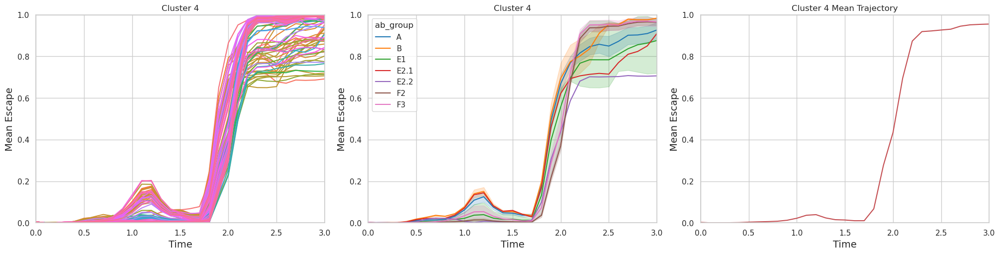

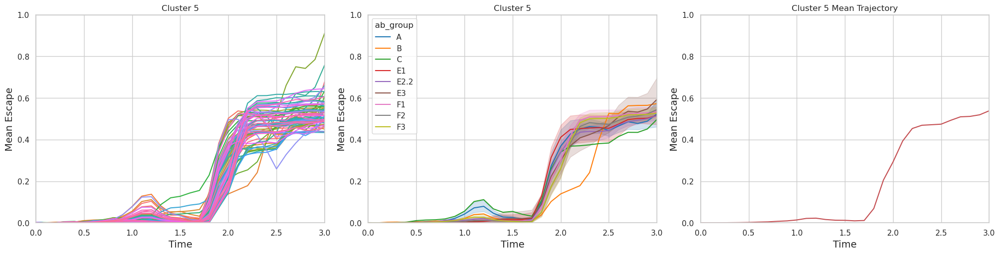

...

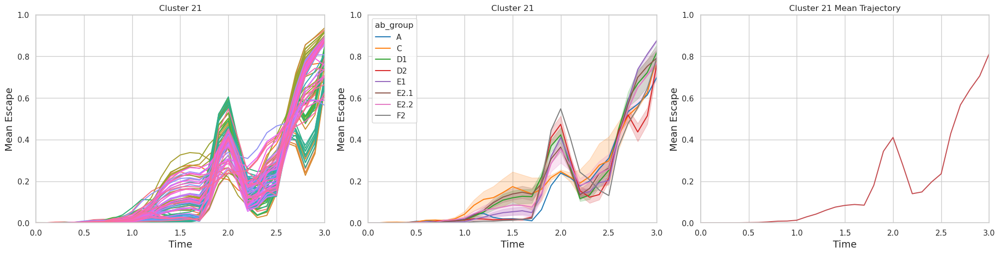

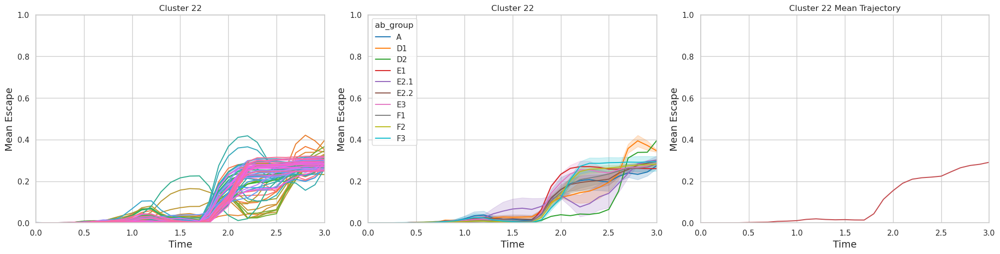

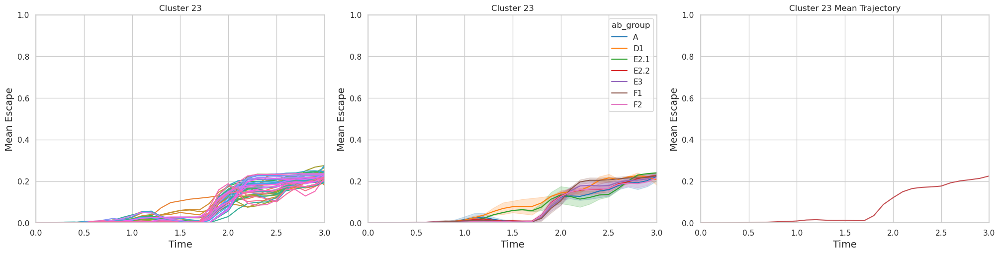

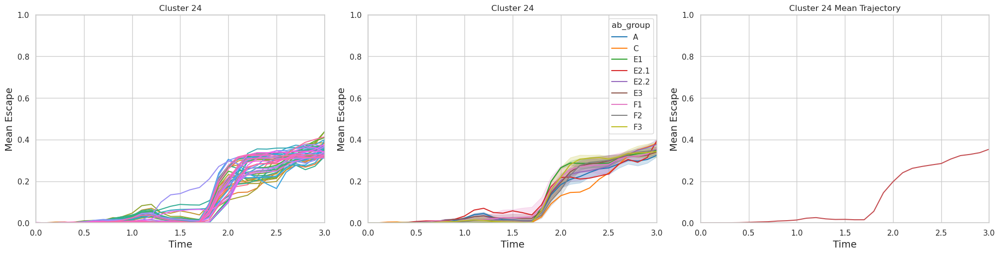

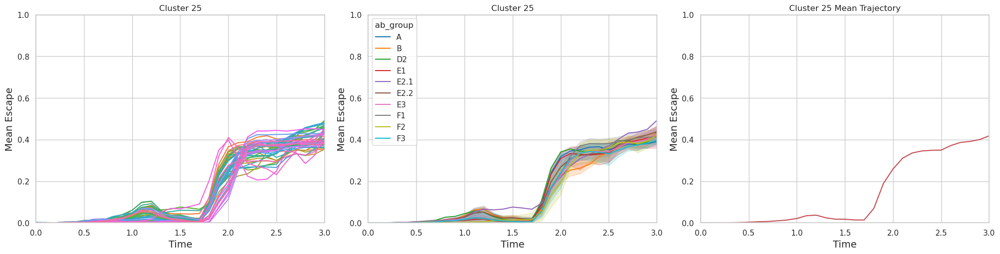

In [50]:
merged_data.tail()


#merging cluter 0 with 1
merged_data['cluster'] = merged_data['cluster'].replace(0, 1)

#merging cluter 9 with 3
merged_data['cluster'] = merged_data['cluster'].replace(9, 3)

#merging cluter 14 with 7
merged_data['cluster'] = merged_data['cluster'].replace(14, 7)

#merging cluter 10 with 11 with 2
merged_data['cluster'] = merged_data['cluster'].replace(10, 2)
merged_data['cluster'] = merged_data['cluster'].replace(11, 2)

#merging cluter 12 with 16
merged_data['cluster'] = merged_data['cluster'].replace(12, 16)

#merging cluter 14 with 15 with 4
merged_data['cluster'] = merged_data['cluster'].replace(14, 4)
merged_data['cluster'] = merged_data['cluster'].replace(15, 4)

#merging cluter 20 with 21
merged_data['cluster'] = merged_data['cluster'].replace(20, 21)


for cluster in range(num_clusters):
    # Filter the data for the current cluster
    cluster_df = merged_data[merged_data['cluster'] == cluster]

    if not cluster_df.empty:
        # Initialize a grid of 3 horizontal plots
        fig, axs = plt.subplots(1, 3, figsize=(20, 5), constrained_layout=True)
        
        # Normal plot with all antibodies in the cluster
        sns.lineplot(data=cluster_df, x='time', y='mean_escape', hue='antibody', ax=axs[0], legend=False)
        axs[0].set_title(f'Cluster {cluster}')
        axs[0].set_xlabel('Time', fontsize=14)
        axs[0].set_ylabel('Mean Escape', fontsize=14)

        # Plot classified by antibody group
        sns.lineplot(data=cluster_df, x='time', y='mean_escape', hue='ab_group', palette='tab10', ax=axs[1])
        axs[1].set_title(f'Cluster {cluster}')
        axs[1].set_xlabel('Time', fontsize=14)
        axs[1].set_ylabel('Mean Escape', fontsize=14)

        # Plot displaying mean trajectory
        sns.lineplot(data=cluster_df, x='time', y='mean_escape', ci=None, estimator=np.mean, color='r', ax=axs[2])
        axs[2].set_title(f'Cluster {cluster} Mean Trajectory')
        axs[2].set_xlabel('Time', fontsize=14)
        axs[2].set_ylabel('Mean Escape', fontsize=14)
        
        # set x and y axis limits (adjust according to your specific data range)
        for ax in axs:
            ax.set_xlim([0, 3])  
            ax.set_ylim([0, 1])  
        
        # Show the plot
        plt.show()
        

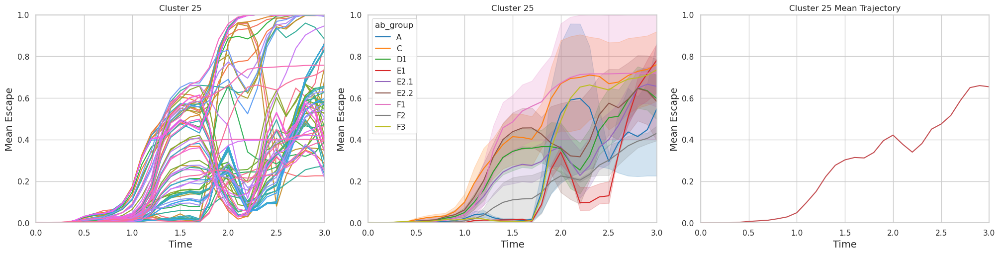

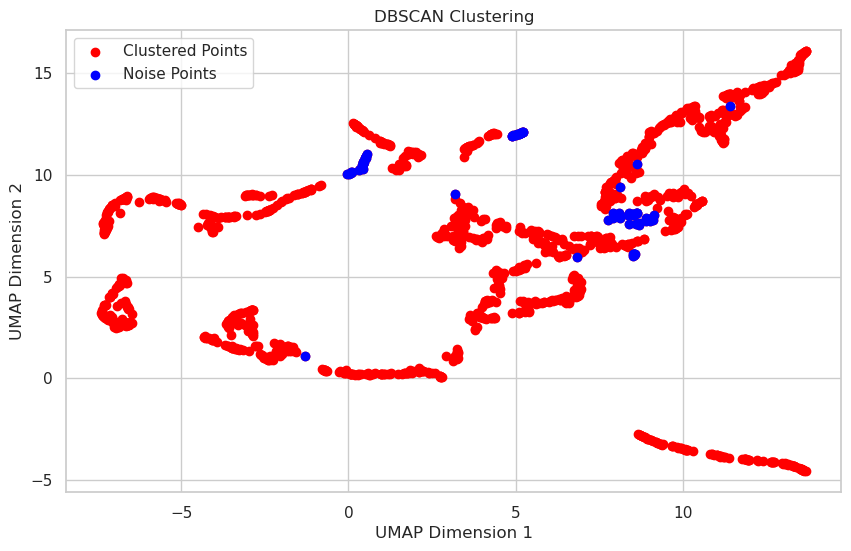

In [51]:
# Filter the data for the current cluster
cluster_df = merged_data[merged_data['cluster'] == -1]

if not cluster_df.empty:
        # Initialize a grid of 3 horizontal plots
        fig, axs = plt.subplots(1, 3, figsize=(20, 5), constrained_layout=True)
        
        # Normal plot with all antibodies in the cluster
        sns.lineplot(data=cluster_df, x='time', y='mean_escape', hue='antibody', ax=axs[0], legend=False)
        axs[0].set_title(f'Cluster {cluster}')
        axs[0].set_xlabel('Time', fontsize=14)
        axs[0].set_ylabel('Mean Escape', fontsize=14)

        # Plot classified by antibody group
        sns.lineplot(data=cluster_df, x='time', y='mean_escape', hue='ab_group', palette='tab10', ax=axs[1])
        axs[1].set_title(f'Cluster {cluster}')
        axs[1].set_xlabel('Time', fontsize=14)
        axs[1].set_ylabel('Mean Escape', fontsize=14)

        # Plot displaying mean trajectory
        sns.lineplot(data=cluster_df, x='time', y='mean_escape', ci=None, estimator=np.mean, color='r', ax=axs[2])
        axs[2].set_title(f'Cluster {cluster} Mean Trajectory')
        axs[2].set_xlabel('Time', fontsize=14)
        axs[2].set_ylabel('Mean Escape', fontsize=14)
        
        # set x and y axis limits (adjust according to your specific data range)
        for ax in axs:
            ax.set_xlim([0, 3])  
            ax.set_ylim([0, 1])  
        
        # Show the plot
        plt.show()
        
        
#NOISE POINTS ON THE UMAP
import matplotlib.pyplot as plt

# Using the same embedding_df DataFrame

# Plotting the clusters
plt.figure(figsize=(10, 6))

# Plot all points in red
plt.scatter(embedding_df['UMAP Dimension 1'], embedding_df['UMAP Dimension 2'], color='red', label='Clustered Points')

# Overplot the noise points with cluster number -1 in blue
plt.scatter(embedding_df[embedding_df['cluster'] == -1]['UMAP Dimension 1'], embedding_df[embedding_df['cluster'] == -1]['UMAP Dimension 2'], color='blue', label='Noise Points')

plt.title('DBSCAN Clustering')
plt.xlabel('UMAP Dimension 1')
plt.ylabel('UMAP Dimension 2')
plt.legend()
plt.show()


START OF HDBSCAN

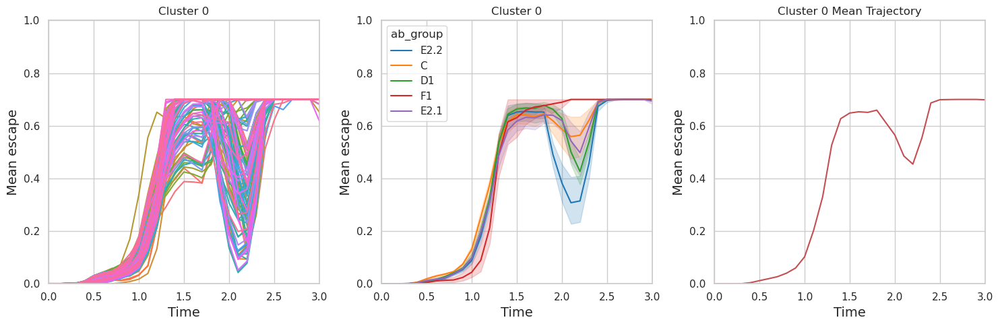

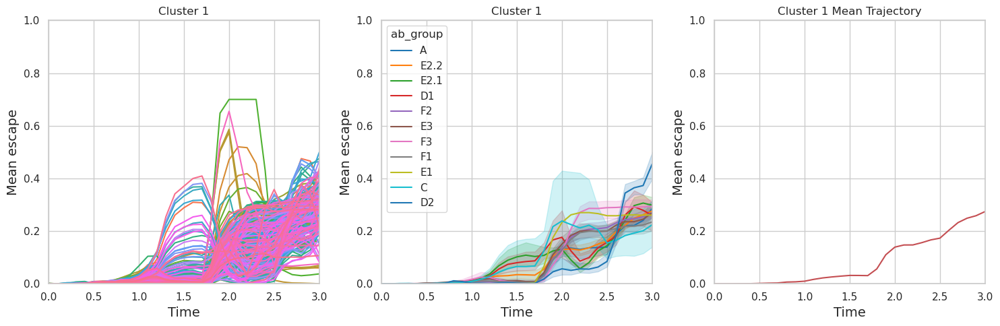

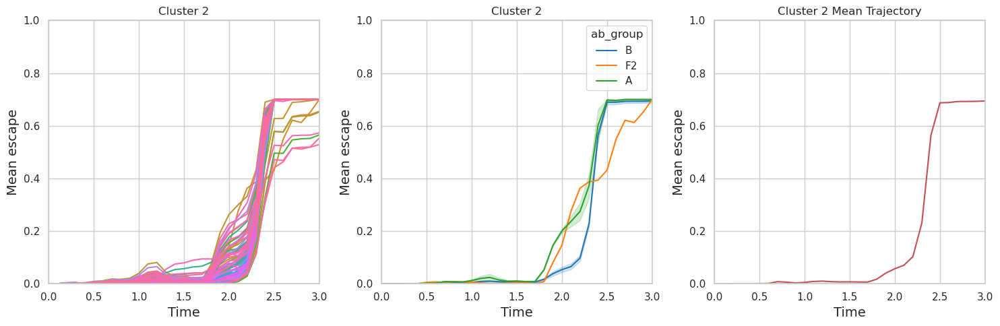

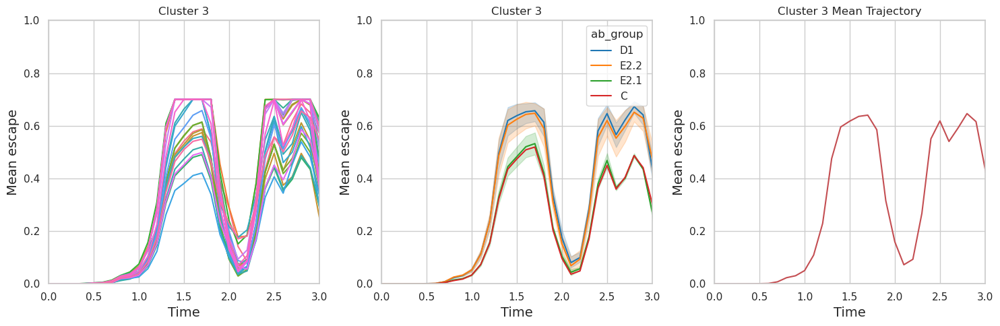

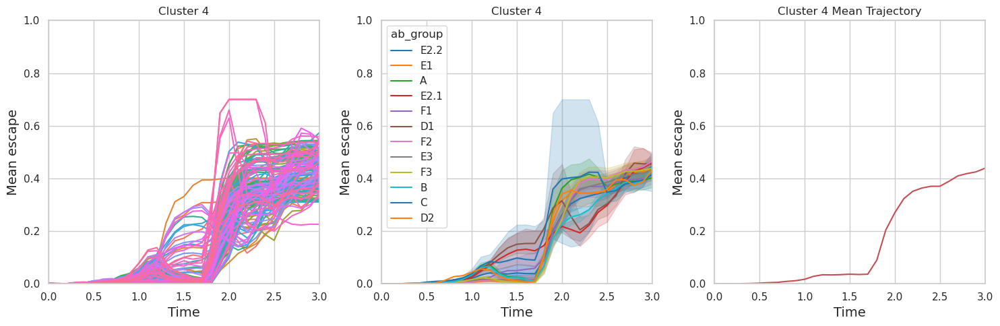

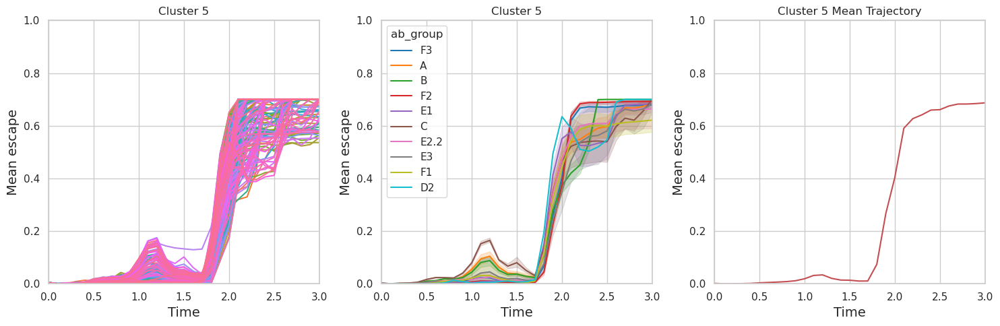

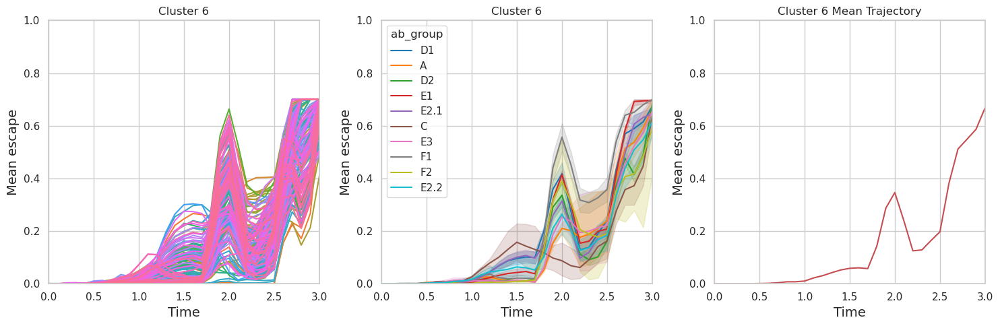

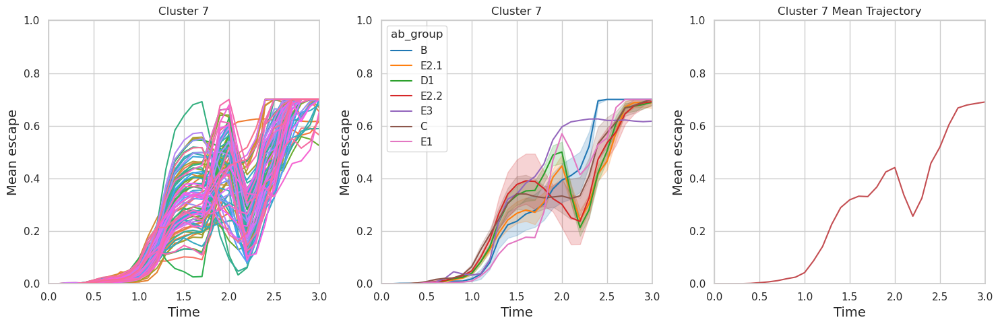

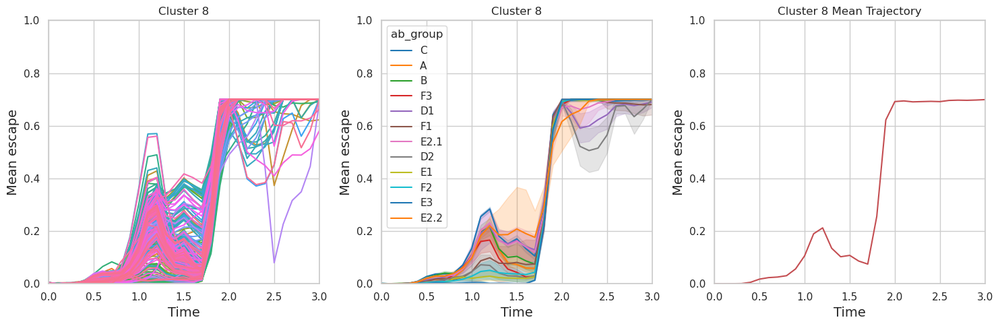

In [52]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import hdbscan
from sklearn.metrics.pairwise import pairwise_distances

# Perform HDBSCAN clustering
clusterer = hdbscan.HDBSCAN(min_cluster_size=20,  # Try lowering this to include smaller clusters
    min_samples=2,       # Try decreasing this to make it easier for points to be considered core points
    cluster_selection_epsilon=0.1, )  # Adjust parameters as needed
clusterer.fit(pivot_df)

# Add the cluster labels back into the pivot dataframe
pivot_df['cluster'] = clusterer.labels_

mean_trajectory_df = pd.DataFrame(columns=['cluster', 'time', 'mean_value'])
antibody_count_per_cluster = {}
antibody_cluster_df = pd.DataFrame(columns=['Cluster', 'Antibody'])

unique_clusters = set(clusterer.labels_)
for cluster in unique_clusters:
    if cluster == -1:
        continue  # Skip the noise points

    cluster_df = pivot_df[pivot_df['cluster'] == cluster].drop(columns='cluster').reset_index()
    cluster_df = cluster_df.melt(id_vars=['ab_group', 'antibody'])
    cluster_df.time = cluster_df.time.astype(float)
    
    # Count the number of unique antibodies in this cluster and update the dictionary
    num_antibodies = cluster_df['antibody'].nunique()
    antibody_count_per_cluster[cluster] = num_antibodies
    
    # Get the unique antibodies in this cluster
    unique_antibodies = cluster_df['antibody'].unique()  
    
    # Create a DataFrame mapping each unique antibody to this cluster
    temp_df = pd.DataFrame({'Cluster': [cluster]*len(unique_antibodies), 'Antibody': unique_antibodies})
    
    # Append this mapping to antibody_cluster_df
    antibody_cluster_df = pd.concat([antibody_cluster_df, temp_df], ignore_index=True)
    
    # Calculate mean trajectory for this cluster
    mean_trajectory = cluster_df.groupby('time')['value'].mean().reset_index()
    mean_trajectory['cluster'] = cluster
    
    # Append the mean trajectory to the DataFrame
    mean_trajectory_df = pd.concat([mean_trajectory_df, mean_trajectory.rename(columns={'value': 'mean_value'})])
    
    # Start subplots
    fig, axs = plt.subplots(1, 3, figsize=(15, 5))
    
    # Normal plot with all antibodies in the cluster
    sns.lineplot(data=cluster_df, x='time', y='value', hue='antibody', ax=axs[0], legend=False)
    axs[0].set_title(f'Cluster {cluster}')
    axs[0].set_xlabel('Time', fontsize=14)
    axs[0].set_ylabel('Mean escape', fontsize=14)
    
    # Plot classified by antibody group
    sns.lineplot(data=cluster_df, x='time', y='value', hue='ab_group', palette='tab10', ax=axs[1])
    axs[1].set_title(f'Cluster {cluster}')
    axs[1].set_xlabel('Time', fontsize=14)
    axs[1].set_ylabel('Mean escape', fontsize=14)
    
    # Plot displaying mean trajectory
    sns.lineplot(data=cluster_df, x='time', y='value', ci=None, estimator=np.mean, color='r', ax=axs[2])
    axs[2].set_title(f'Cluster {cluster} Mean Trajectory')
    axs[2].set_xlabel('Time', fontsize=14)
    axs[2].set_ylabel('Mean escape', fontsize=14)
    
    # set x and y axis limits
    axs[0].set_xlim([0, 3])
    axs[0].set_ylim([0, 1])
    axs[1].set_xlim([0, 3])
    axs[1].set_ylim([0, 1])
    axs[2].set_xlim([0, 3])
    axs[2].set_ylim([0, 1])
    
    # Show the plot
    plt.tight_layout()
    plt.show()


END OF HDBSCAN

# Comparing Kmeans on original Dataset versus HDBSCAN on UMAP

## Accuracy
* while Utelizing the Kmeans algorithmn on the original dataset is simpler for interpretation, the results are not amazing. Some clusters have great variation, some have veryy accurate trajectories and are tightly knit, its not very reliable in that sense, or consistent
* Utelizing HDBSCAN on the UMAP analysis, yelids many, yet accurate clusters. The lines that have distinct patterns are indeed separated and the algirithemn is very consistent with its method of separating since nearly all clusters have distinct or unique patterns that are separate from the other clusters

## Complicated?
* Using Kmeans wouled be the less complicated route for this clustersing, where the algorithmen is run on our dataset and does its comparisions with teh timepoints nad hte mean escapes at the timepoints for each antibody then its yeailds its reults that we graph. THis is just a one step proccess, but as we said before the results are good, but not great, the accuracc y and distinguishibility for each cluster isnt the best that it can be. 
* On the other hand, Using HDBSCAN on the UMAP is a more complicated proccess. 
    * First, we take the antibody points and their escape scores and create a euclidean disctance matrix
    * We then run this distance Matric through the UMAP Dimentionality Reduction Analysis where it reduces the dimentions and represents them on the a scatter plot, where each dot represents an antibody, and the discantce between them is the similarity between them in a sense
    * We then run the UMAP Scatter Plot through the HDBSCAN algorithemn that then clusters the points
    
## Reason for Results?
* I belive that the HDBSCAN analysis is more accurate beacuse oits much more simple for it to cluster on points on a graph rather than looking at multiple datapoints and making certain comparisons. The results yeilded were more accurate and this could also be due to the way that the UMAP reduces the dimensions, as its algorithmn could be very accurate, and noe coupled with HDBSCAN, teh reults are better then the original KMEANS clustering 

## Future
* Pretty much, all that needs to be done would be to put together super similar graphs from teh HDBSCAN, and wed have a complete

## UMAP Antibody Cluster Analysis Take Aways
* Here, we see different results. Different clusters are very distinct and separate from other clusters
* What may need to be explored more is the fact that first, most of the dots are in one jumble, leading from one clsuter to the other. Second, we need to see why cluster 2 is spread the way it is and cluster 0 has a great separation
* Whats nice about what we have is we do see distinct clsuter groups, and cluster 1 is very distinct and away on its own, as well as some other clusters

## Insights from Cluster Analysis
* Initially, one might assume that each cluster would correspond directly to a specific antibody group.
* However, post-analysis reveals that clusters don't align neatly with antibody groups. Instead, the data unveils diverse patterns and correlations across various graphs.
* Some antibody groups span multiple clusters, while others predominantly populate a single cluster.
* These findings open a plethora of avenues for interpretation and further study.